In [1]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn('LightFM was compiled without OpenMP support. '


In [2]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

In [139]:
Int = pd.read_csv('Interactions.csv')
items = pd.read_csv("items.csv")

In [5]:
prods_coding = pd.read_csv("./products_coding.csv")

In [6]:
Int.head()

,vid,product_id,page_type,picture_url
0,0,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
1,1,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...
2,2,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
3,3,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
4,4,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...


In [7]:
Int["page_type"].value_counts()

PRODUCT     1844383
CART         746453
PURCHASE      50052
Name: page_type, dtype: int64

In [8]:
dict_converter = dict(zip(prods_coding.id, prods_coding.int_id))

In [9]:
items["product_id"] = items["product_id"].map(dict_converter)
items.dropna(inplace=True)
items["product_id"] = items["product_id"].astype(int)

In [10]:
items.rename(columns={"all_text": "text"}, inplace=True)

In [11]:
items = items.reset_index(drop=True)

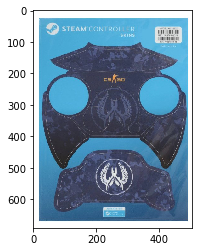

In [12]:
r = requests.get(items["picture_url"][12])
im = Image.open(BytesIO(r.content))
plt.imshow(im)

In [13]:
Int = Int.drop_duplicates().reset_index(drop=True)

In [14]:
Int["page_type"].value_counts()

PRODUCT     1368543
CART         231905
PURCHASE      48487
Name: page_type, dtype: int64

In [15]:
counts = Int[["vid", "product_id"]].drop_duplicates().groupby("vid")["product_id"].count().reset_index()

In [16]:
Int = Int.merge(counts[counts["product_id"] >= 2][["vid"]], on="vid")

In [17]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on=["picture_url"])

In [18]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
Int["vid"] = le.fit_transform(Int["vid"])
Int["product_id"] = le.fit_transform(Int["product_id"])

In [19]:
items.shape

(60627, 4)

In [20]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Холодный старт

# Самые популярные

Посмотрим, какие товары у нас самые популярные в разных разрезах (просмотр / корзина / покупка) 

In [176]:
class Top():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self):
        # Хотим получить в отсортированном порядке датафрейм - product_id, user_number
        items = self.interactions[self.interactions["page_type"] == "PURCHASE"]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:30]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [177]:
T = Top(Int)

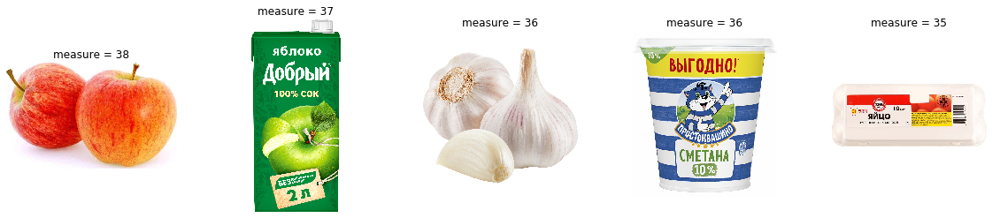

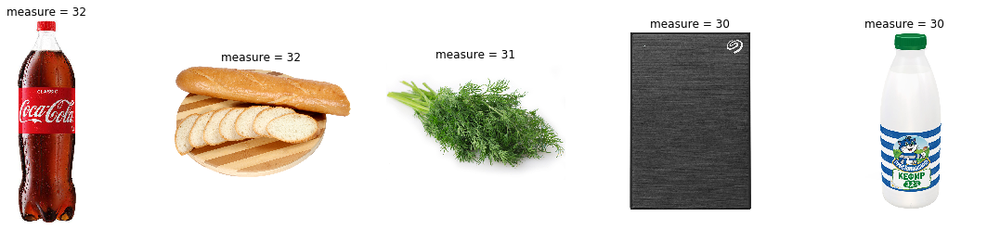

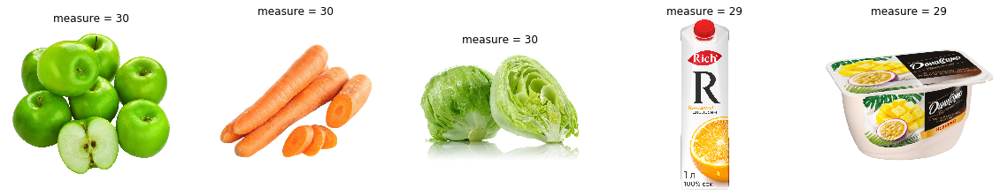

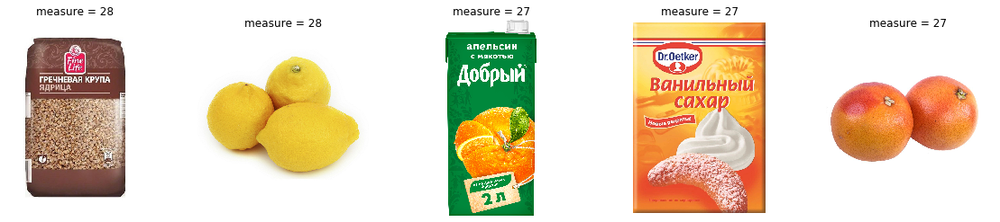

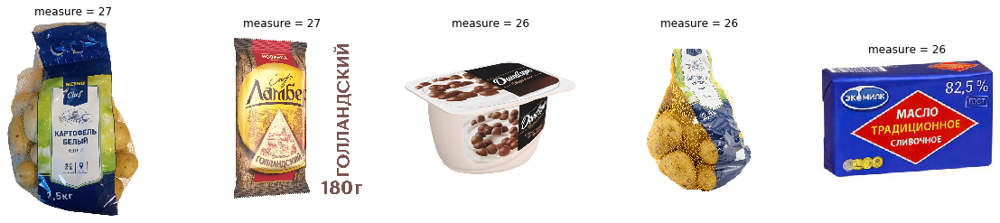

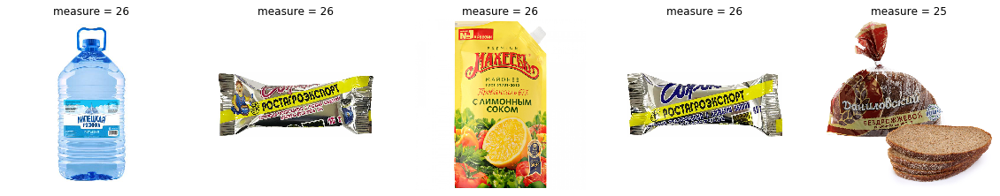

In [178]:
T.top_items()

In [181]:
Int["vid"].nunique()

904458

In [182]:
Int["product_id"].nunique()

60627

# Cовстречаемость

In [189]:
Int.head()

,vid,product_id,page_type,picture_url
0,0,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
1,1,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...
2,2,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
3,3,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...
4,4,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...


In [183]:
Int_tmp = Int[["vid", "product_id"]].drop_duplicates()

In [184]:
Int_tmp.head()

,vid,product_id
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0


In [185]:
user_products = Int_tmp.groupby(["vid"])["product_id"].apply(list).reset_index()

In [27]:
user_products[:3]

,vid,product_id
0,0,"[0, 10329, 21884, 30040, 33103, 56320]"
1,1,"[0, 46486, 56182]"
2,2,"[0, 32714, 35441, 51929, 54515, 55093, 56269]"


In [28]:
class Recomendations():
    def __init__(self, Int):
        # Создаём словарь для того, чтобы по product_id возвращать url товара
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        # Для каждого пользователя собираем товары, с которыми он взамиодействовал
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        # Считаем число товаров, с которыми взаимодействовал каждый пользователь и записываем в колонку prod_num
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        # Фильтруем пользователей, взаимодействовавших с одним товаром
        user_products = user_products[user_products["prod_num"] > 1]
        
        # Заводим словарь под товары
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            # Если товары встетились вместе больше одного раза, то добавляем в список
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [29]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/ipykernel_launcher.py:21: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


In [186]:
cooc_rec.cooc_rec.sort_values("measure", ascending=False).head()

,item1,item2,measure
166295,11077,43975,42
166682,43975,11077,42
166248,1802,43975,41
166680,43975,1802,41
166563,40535,43975,40


Для товара


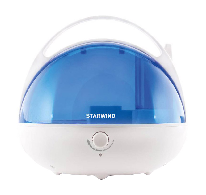

Такие рекомендации


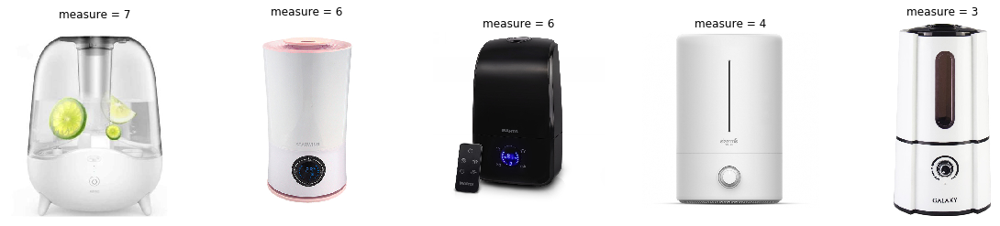

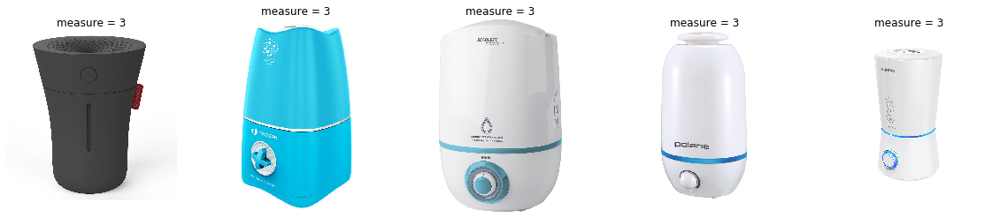

In [31]:
cooc_rec.get_rec(10)

Для товара


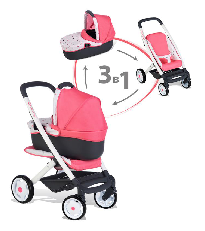

Такие рекомендации


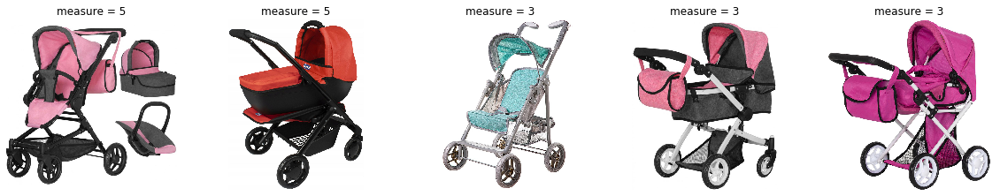

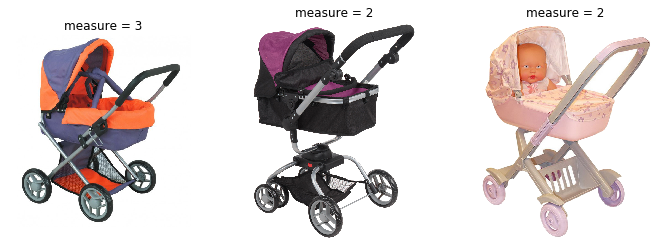

In [32]:
cooc_rec.get_rec(121)

Для товара


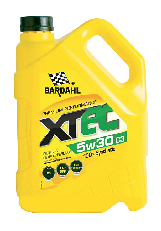

Такие рекомендации


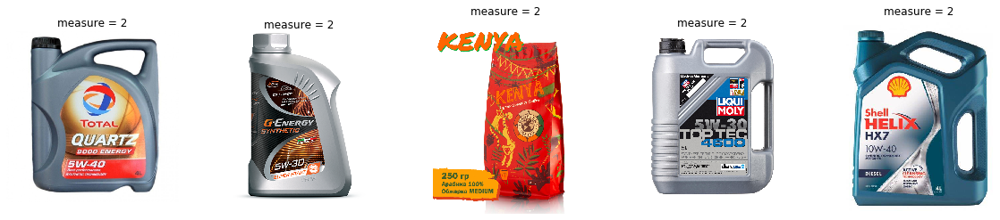

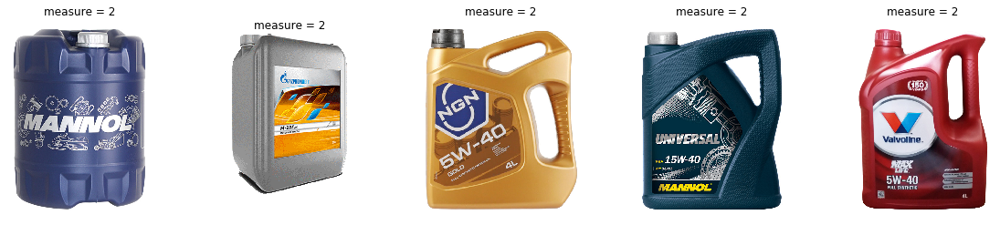

In [33]:
cooc_rec.get_rec(42)

Для товара


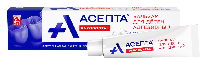

Такие рекомендации


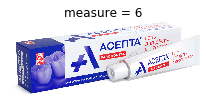

In [34]:
cooc_rec.get_rec(11111)

Для товара


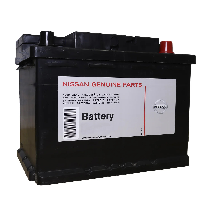

Такие рекомендации


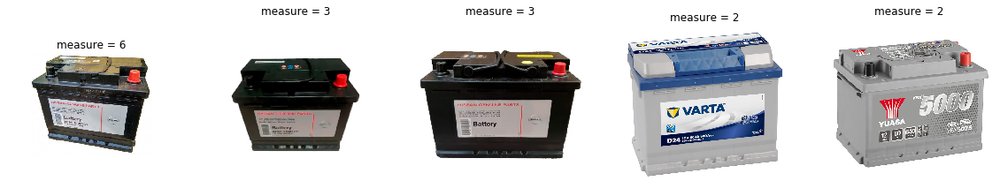

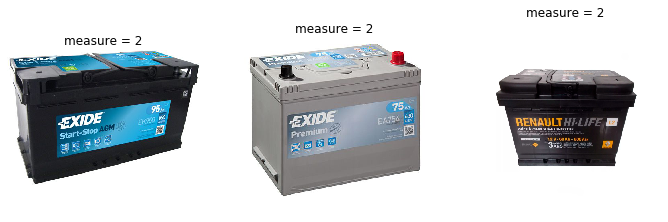

In [188]:
cooc_rec.get_rec(13626)

Для товара


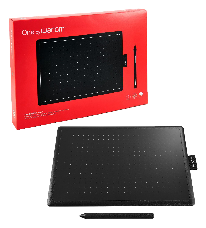

Такие рекомендации


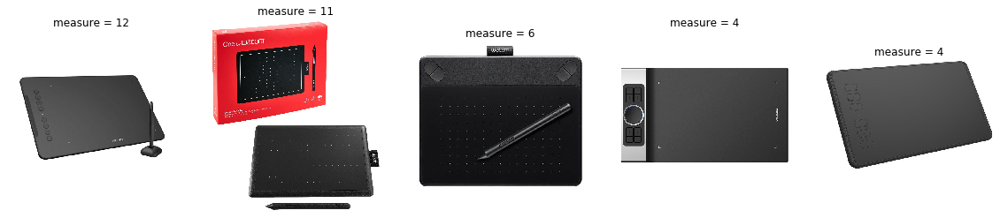

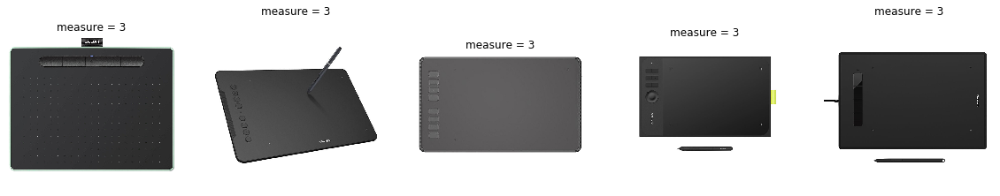

In [38]:
cooc_rec.get_rec(54001)

Для товара


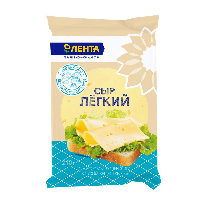

Такие рекомендации


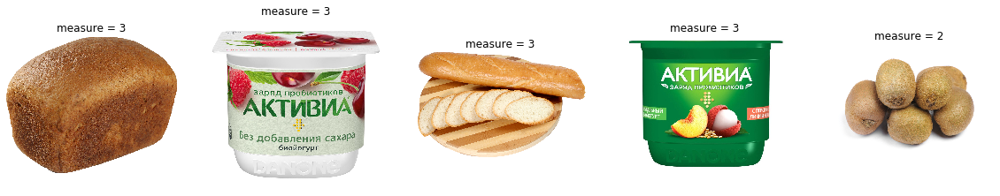

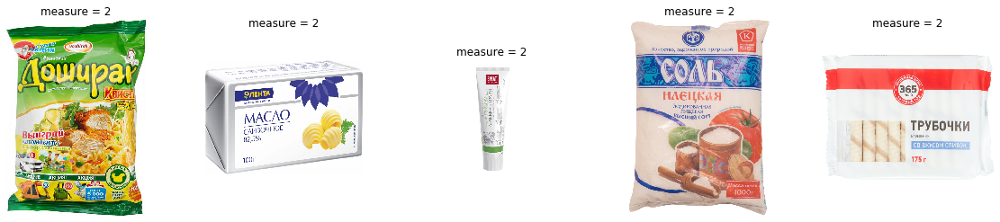

In [39]:
cooc_rec.get_rec(12422)

Для товара


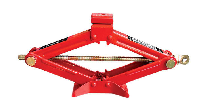

Такие рекомендации


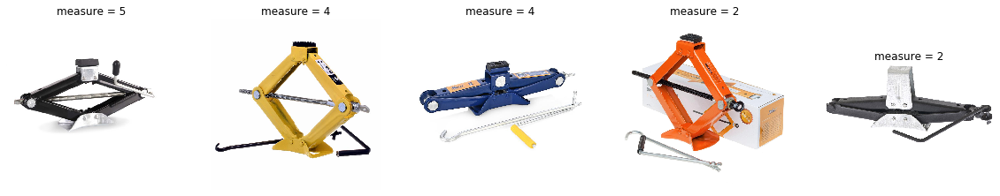

In [40]:
cooc_rec.get_rec(1247)

Для товара


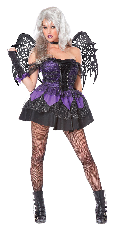

Такие рекомендации


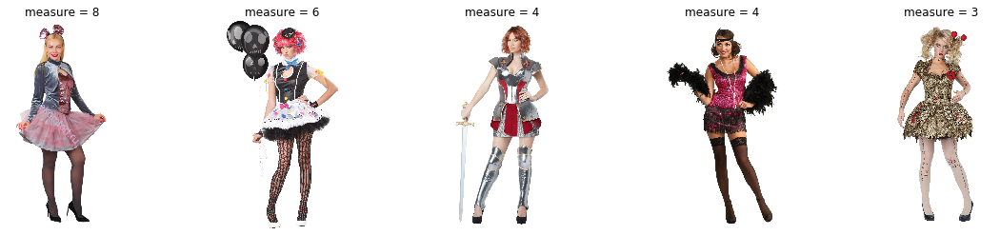

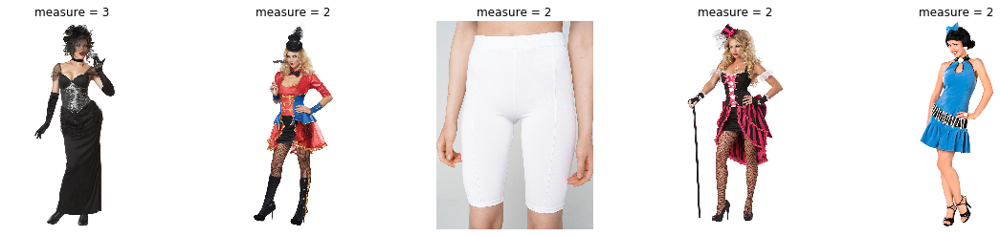

In [41]:
cooc_rec.get_rec(15453)

Для товара


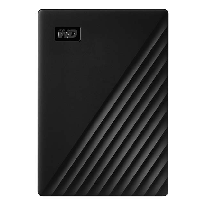

Такие рекомендации


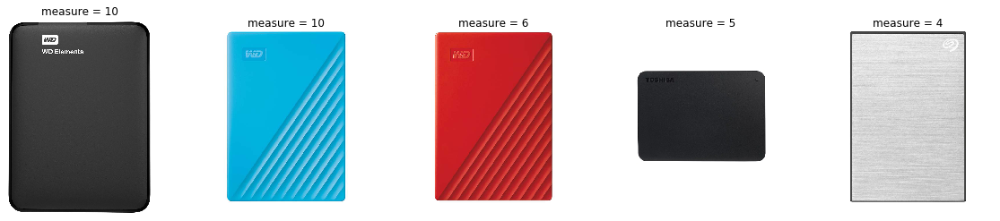

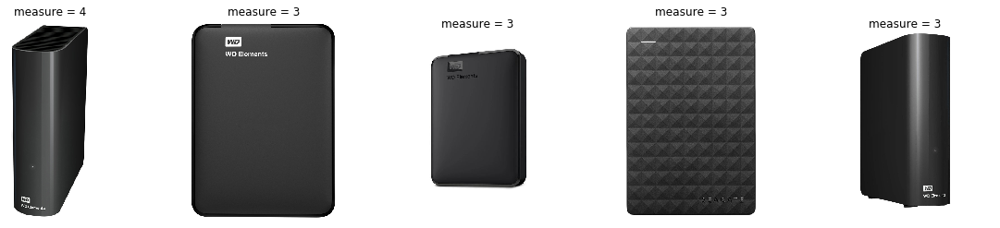

In [42]:
cooc_rec.get_rec(3445)

Для товара


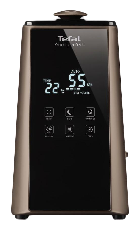

Такие рекомендации


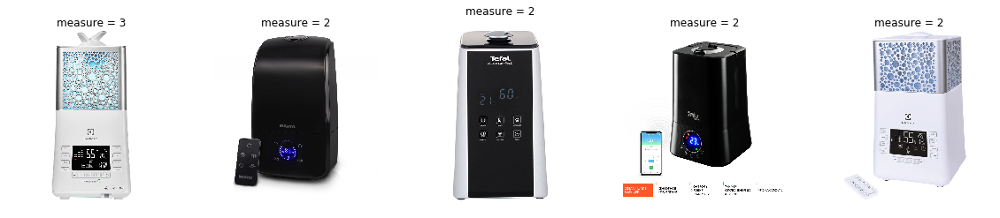

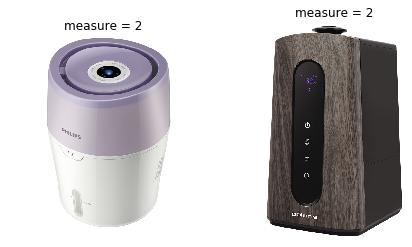

In [43]:
cooc_rec.get_rec(667)

Для товара


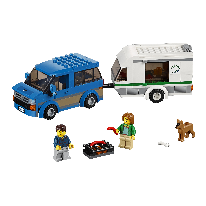

Такие рекомендации


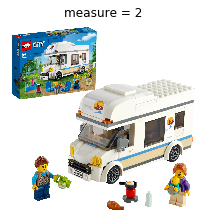

In [44]:
cooc_rec.get_rec(1231)

Для товара


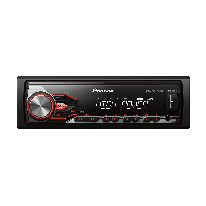

Такие рекомендации


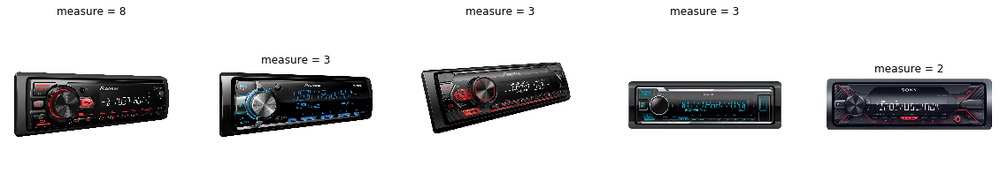

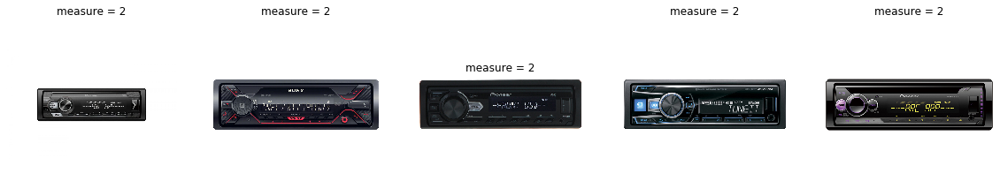

In [45]:
cooc_rec.get_rec(1226)

Для товара


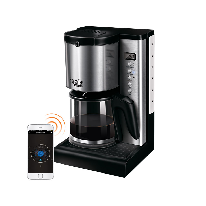

Такие рекомендации


In [46]:
cooc_rec.get_rec(1332)

Для товара


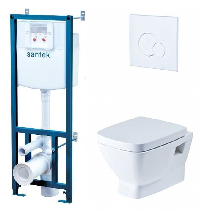

Такие рекомендации


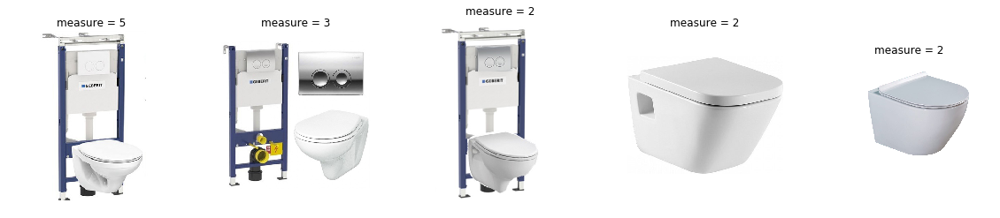

In [47]:
cooc_rec.get_rec(4521)

# Content-based

In [194]:
items["all_text"][55555]

'Куртка мужская GD57000433 DANGER черная M Куртки мужские DANGER'

In [195]:
from tqdm import tqdm_notebook

In [50]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions.drop_duplicates()
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in tqdm_notebook(range(self.items_embs.shape[0])):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:31], self.content_dict, np.sort(metrics)[0][::-1][1:31])

In [51]:
CB = Content_Based(items, Int)

In [52]:
CB.get_items_representation()

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/ipykernel_launcher.py:35: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Для товара


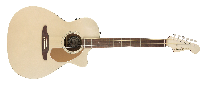

Такие рекомендации
Something went wrong with https://main-cdn.sbermegamarket.ru/hlr-system/225/045/956/720/184/9/600004039251b0.jpeg


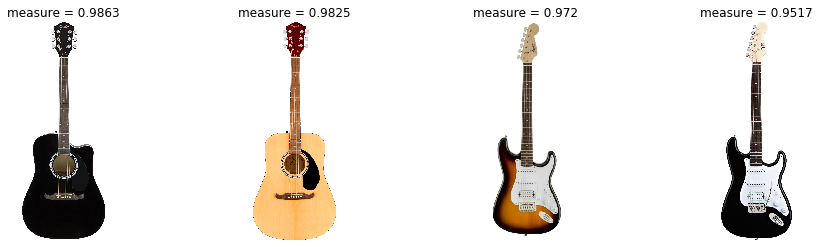

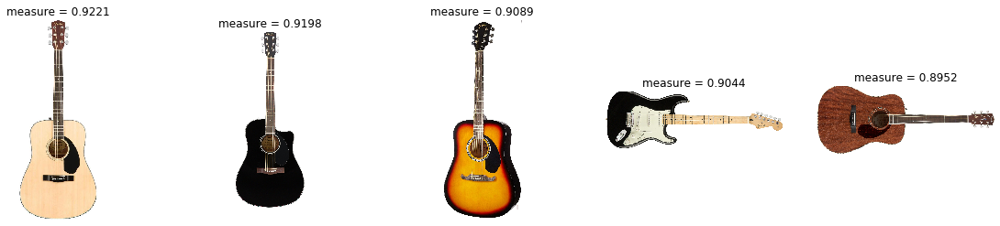

In [53]:
CB.get_rec_I2I(14990)

Для товара


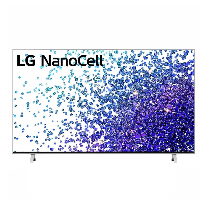

Такие рекомендации


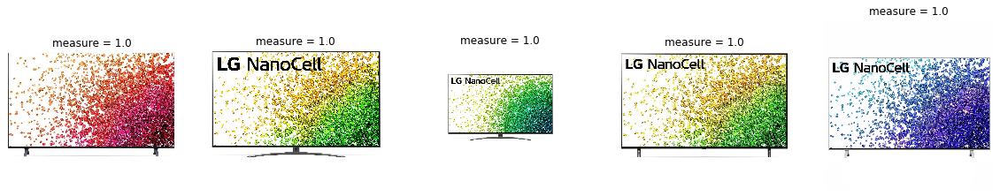

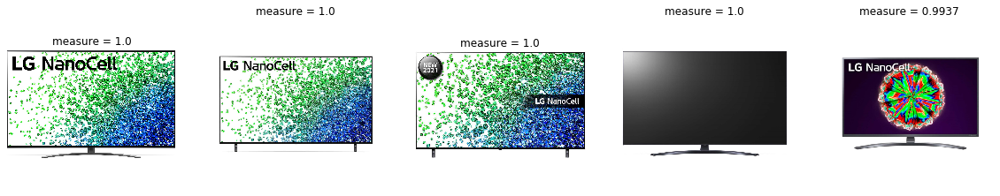

In [54]:
CB.get_rec_I2I(123)

Для товара


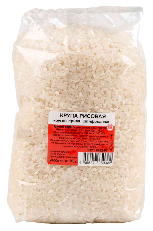

Такие рекомендации


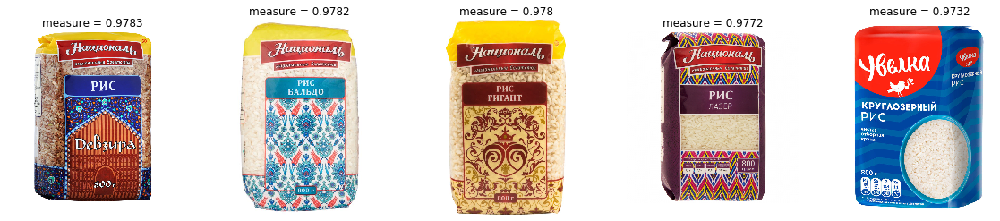

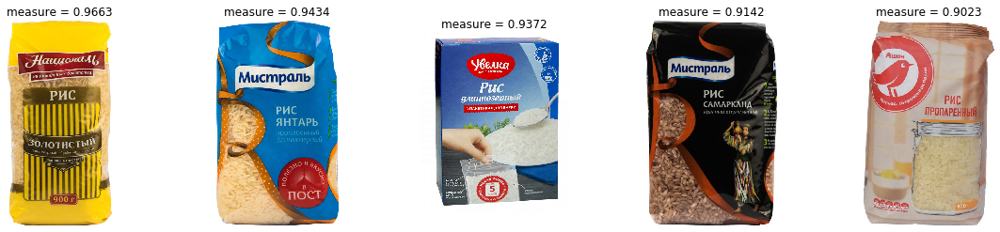

In [55]:
CB.get_rec_I2I(46459)

Для товара


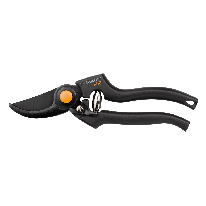

Такие рекомендации


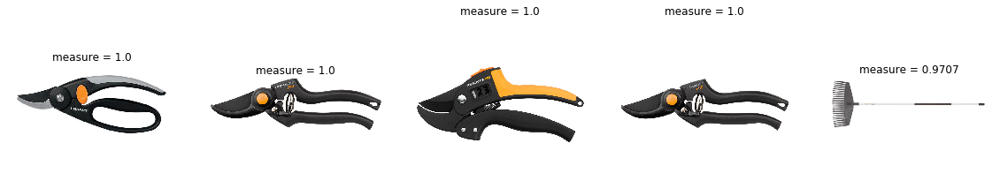

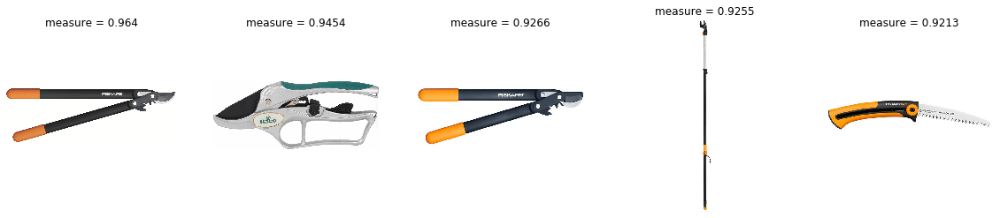

In [56]:
CB.get_rec_I2I(60000)

Для товара


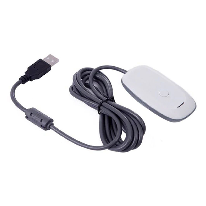

Такие рекомендации


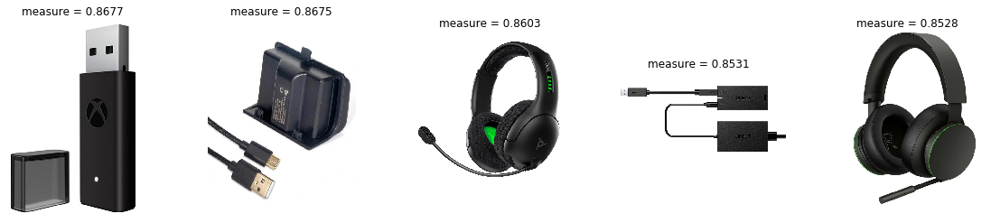

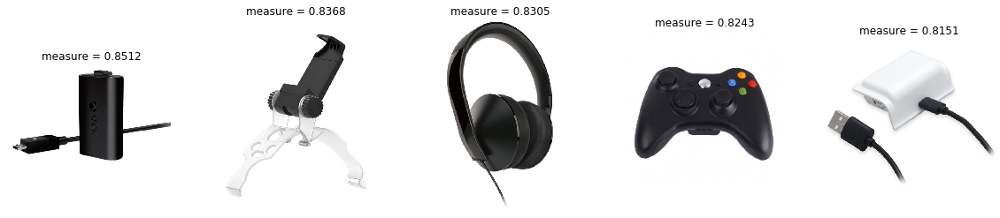

In [57]:
CB.get_rec_I2I(13)

Для товара


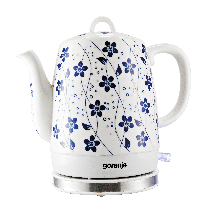

Такие рекомендации


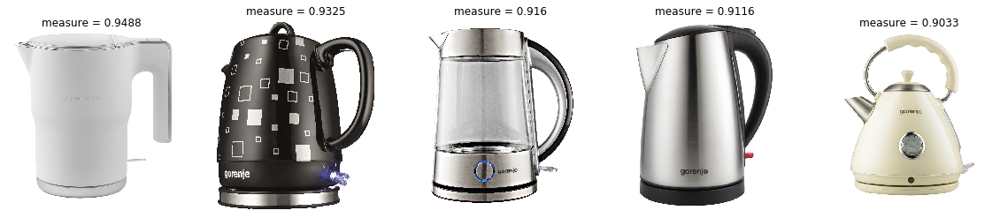

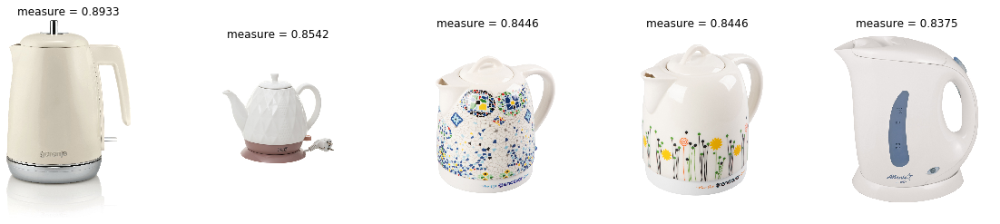

In [58]:
CB.get_rec_I2I(1332)

Для пользователя, который взаимодействовал с товарами


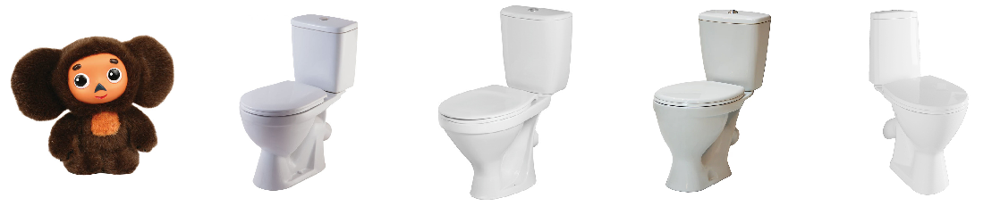

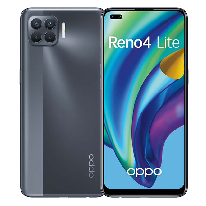

Такие рекомендации


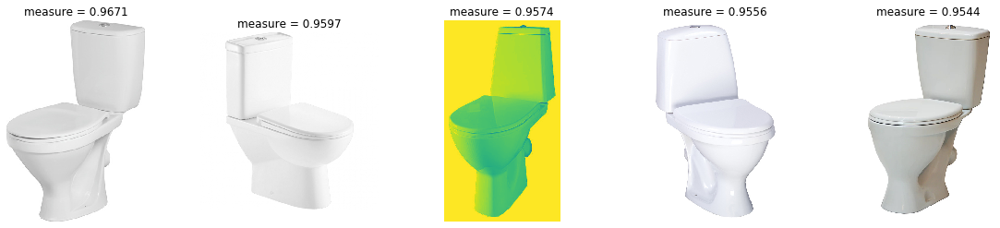

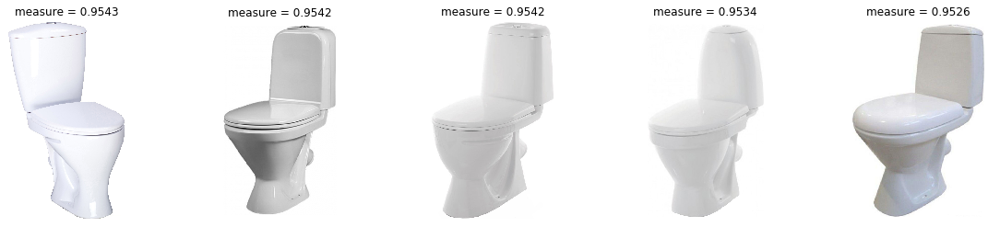

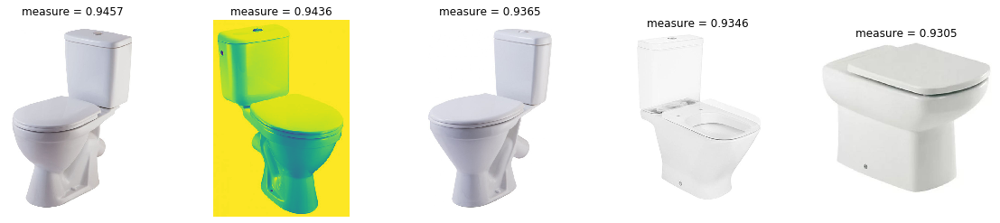

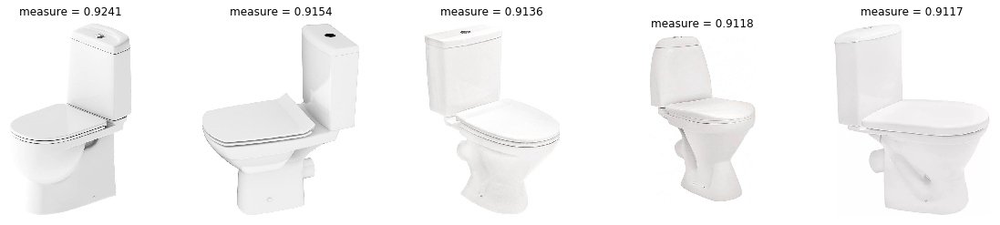

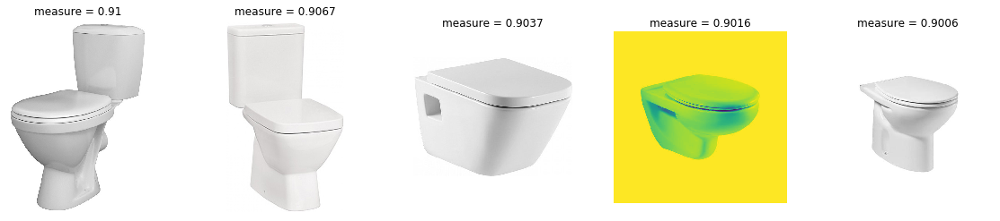

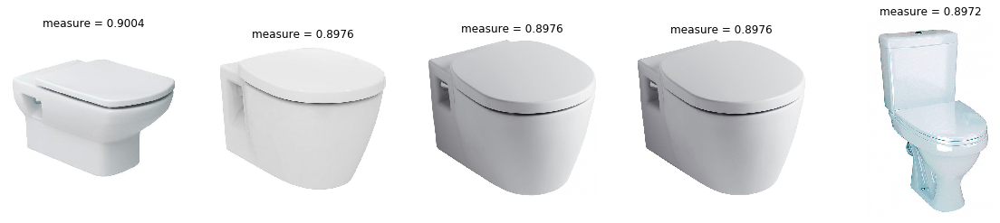

In [59]:
CB.get_rec_U2I(0)

Для пользователя, который взаимодействовал с товарами


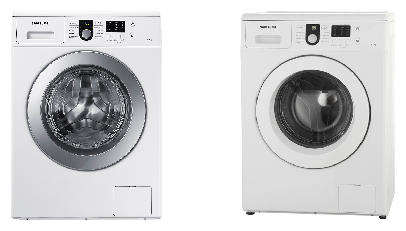

Такие рекомендации


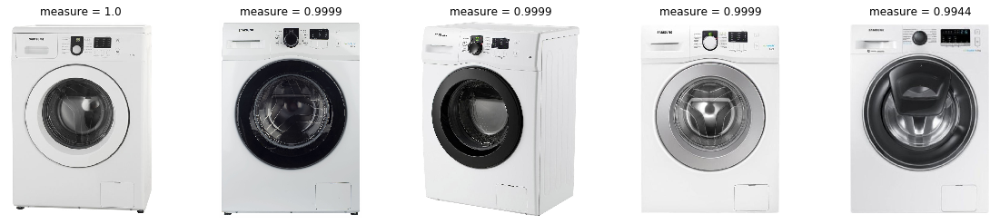

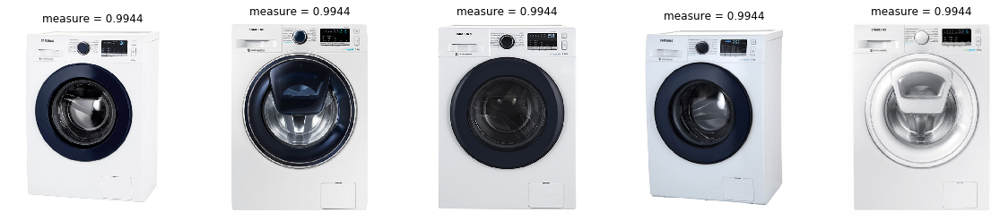

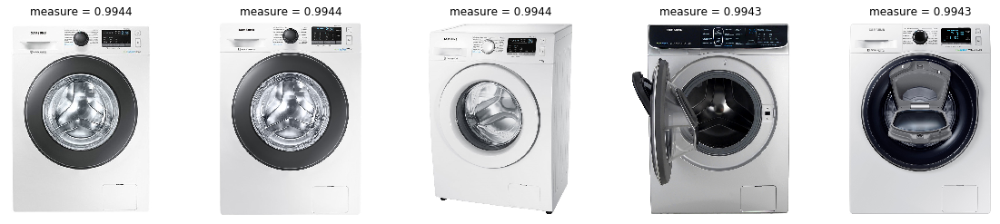

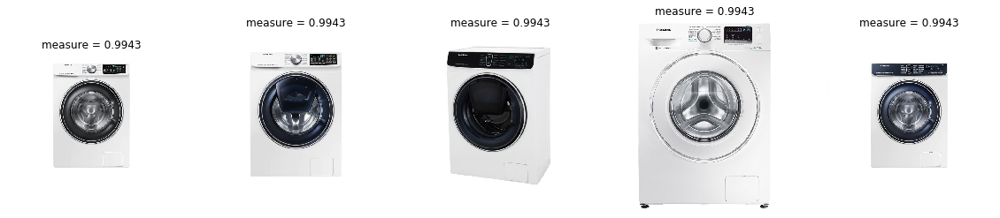

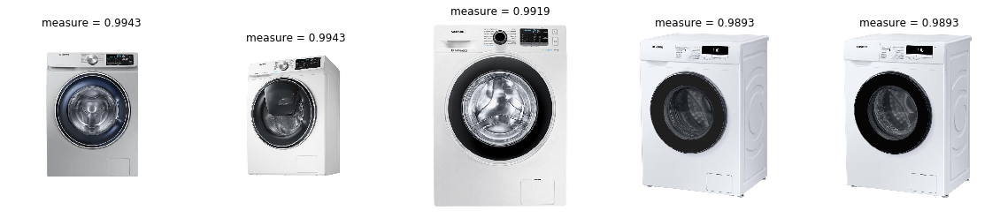

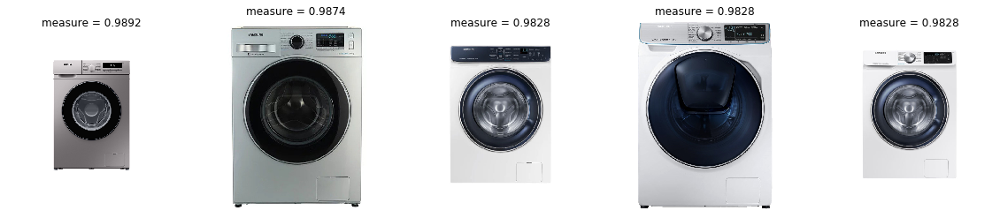

In [60]:
CB.get_rec_U2I(21)

Для пользователя, который взаимодействовал с товарами


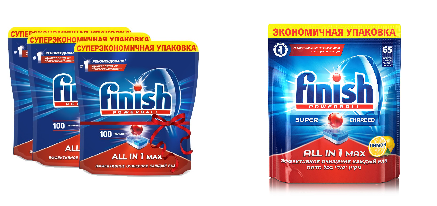

Такие рекомендации


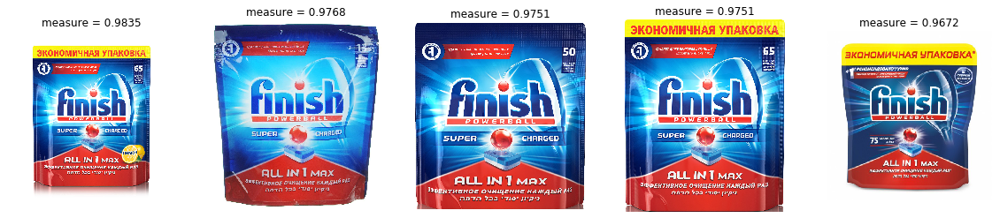

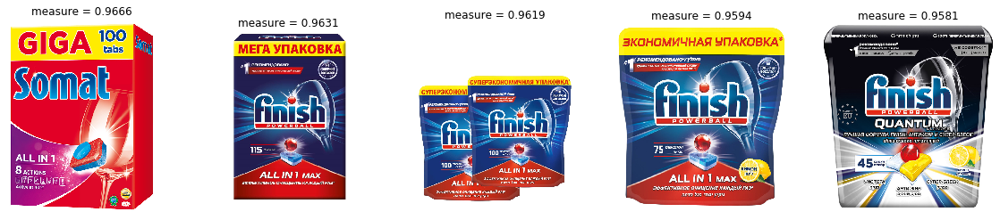

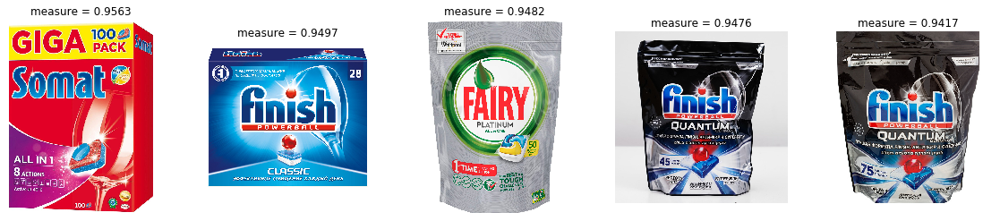

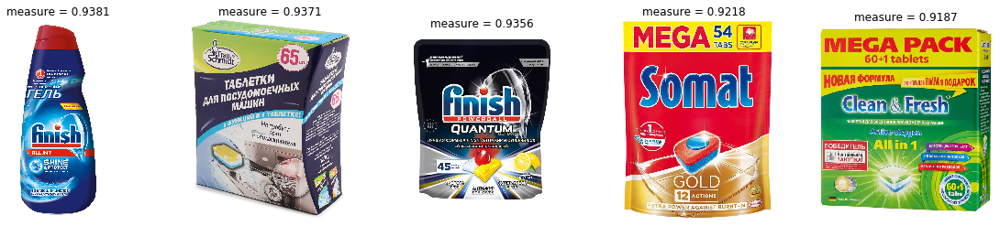

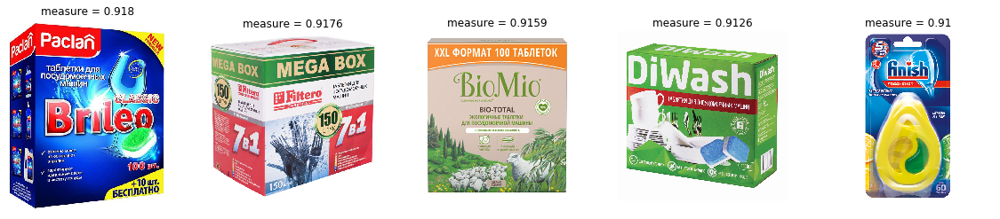

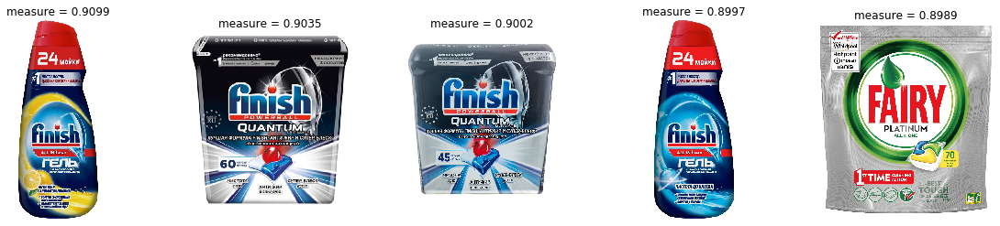

In [61]:
CB.get_rec_U2I(1212)

Для пользователя, который взаимодействовал с товарами


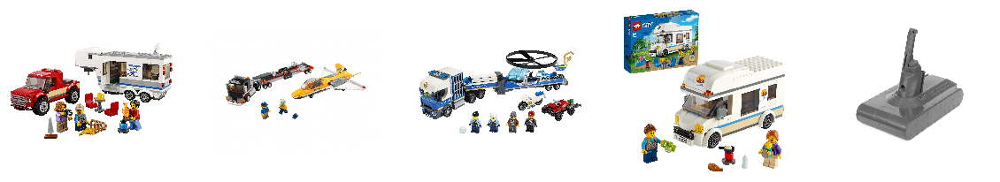

Такие рекомендации


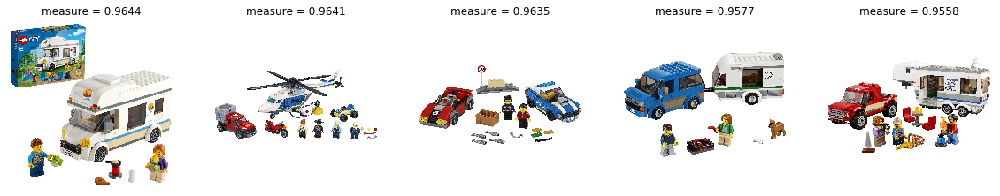

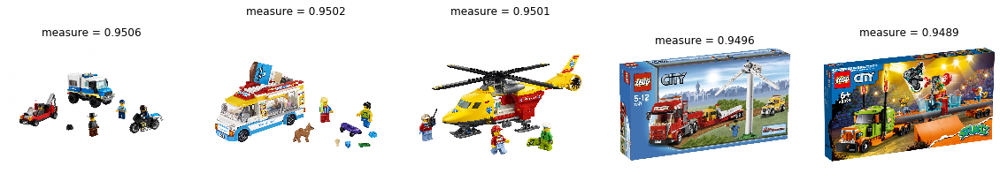

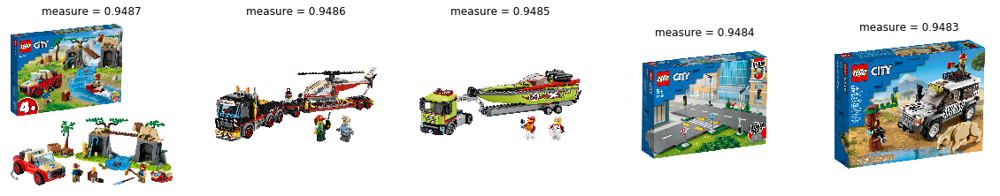

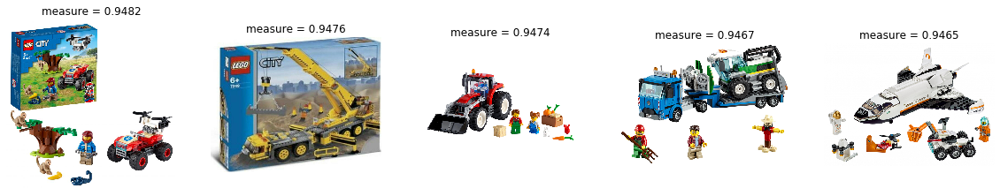

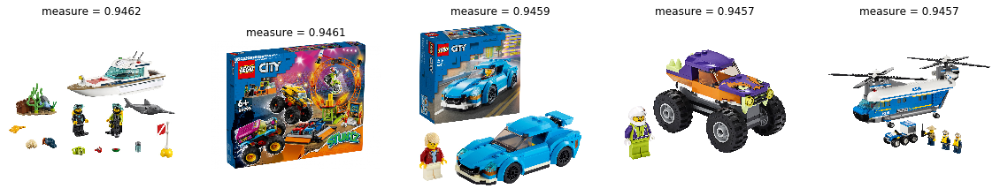

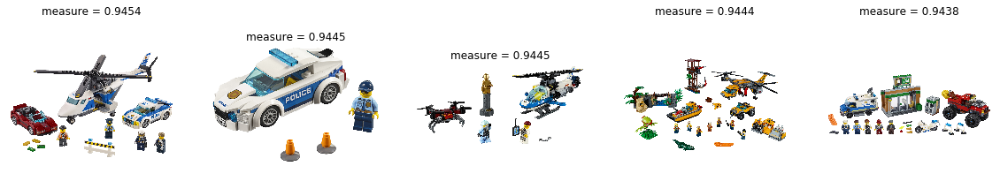

In [62]:
CB.get_rec_U2I(777)

Для пользователя, который взаимодействовал с товарами


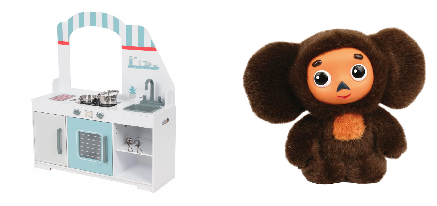

Такие рекомендации


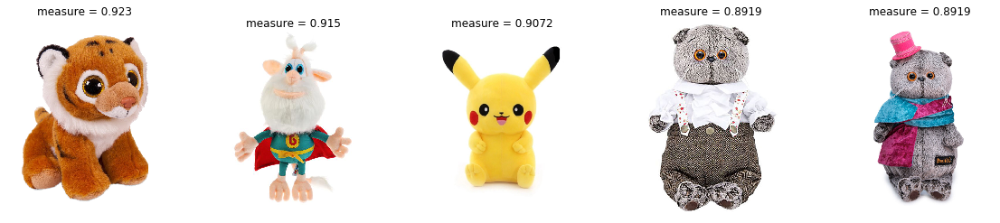

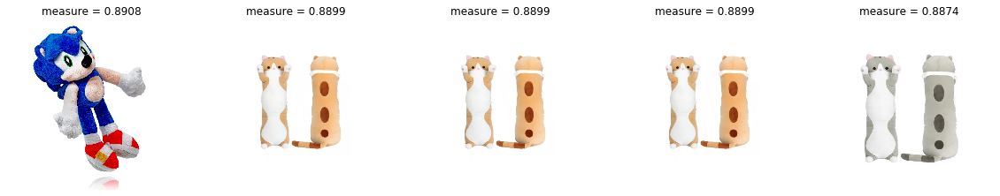

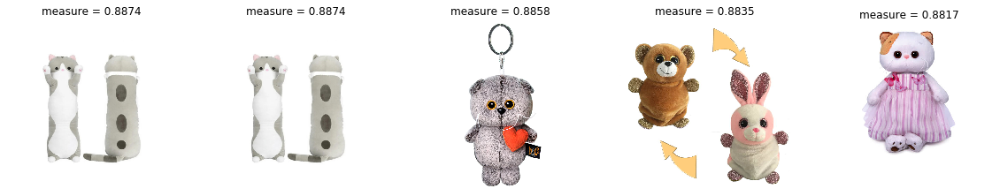

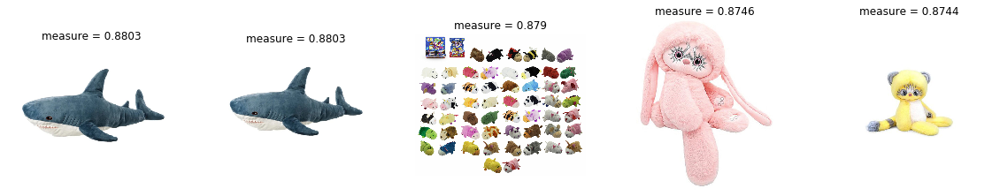

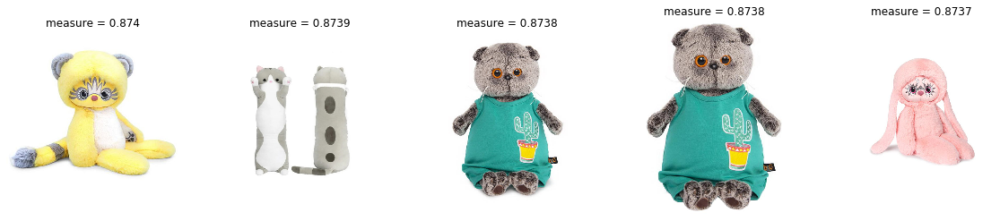

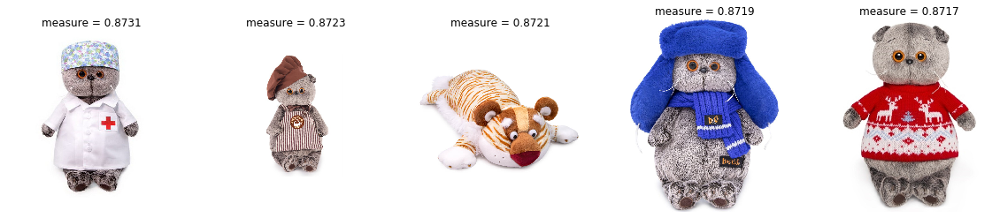

In [63]:
CB.get_rec_U2I(4)

# W2V recommendations

In [64]:
Int

,vid,product_id,page_type,picture_url,text
0,0,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
1,1,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
2,2,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
3,3,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
4,4,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
...,...,...,...,...,...
915609,211599,58093,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Натяжитель поликлинового ремня с роликом Ina 5...
915610,211887,55271,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,"Книга Пойми меня, если сможешь. Почему нас не ..."
915611,212209,58296,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Электровентилятор Отопителя Luzar LFh1755 Вен...
915612,212213,58296,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Электровентилятор Отопителя Luzar LFh1755 Вен...


In [202]:
class W2V_REC():
    def __init__(self, interactions):
        self.interactions = interactions
        self.interactions["product_id"] = self.interactions["product_id"].astype(str)
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j

    def get_w2v(self):
        interactions_sentences = self.interactions.groupby(["vid"])["product_id"].apply(list).reset_index()
        self.model = gensim.models.Word2Vec(
                                        interactions_sentences["product_id"].apply(list).values,
                                        size=200,
                                        window=10,
                                        min_count=1,
                                        workers=10,
                                        iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        
    def avg_feature_vector(self, words):
        feature_vec = np.zeros(200, dtype='float32')
        n_words = 0
        for word in words:
            if word in self.index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, self.model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec
    
    def get_rec_I2I(self, i):
        i = str(i)
        metrics = [j[1] for j in self.model.wv.similar_by_word(i)]
        items = [j[0] for j in self.model.wv.similar_by_word(i)]
        print(u"Для товара")
        r = requests.get(self.content_dict[i])
        im = Image.open(BytesIO(r.content))
        plt.imshow(im)
        plt.axis('off')
        plt.show()
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

    def get_rec_U2I(self, i):
        user_items = list(self.interactions[self.interactions["vid"] == i]["product_id"].drop_duplicates())
        user_emb = self.avg_feature_vector(user_items)
        recs = self.model.wv.most_similar(positive=[user_emb], topn=10)
        metrics = [j[1] for j in recs]
        items = [j[0] for j in recs]
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(user_items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

In [66]:
Int[Int["vid"] == 6001]["product_id"]

314254    5003
469352     468
469353     468
Name: product_id, dtype: int64

In [68]:
w = W2V_REC(Int)
w.get_w2v()

Для пользователя, который взаимодействовал с товарами


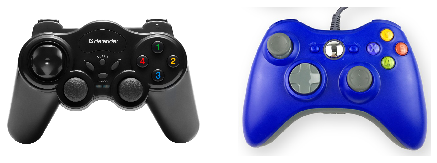

Такие рекомендации


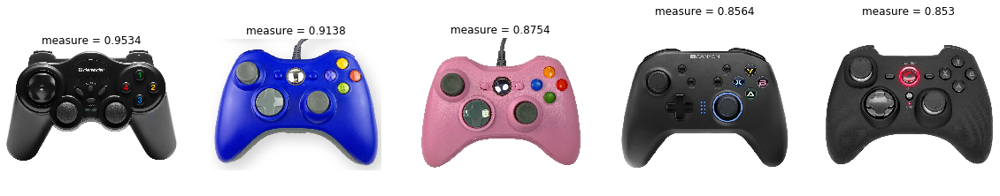

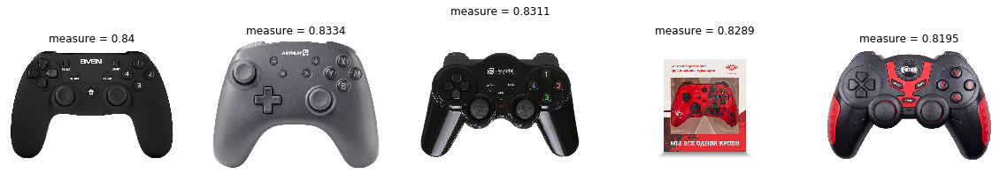

In [69]:
w.get_rec_U2I(62)

Для товара


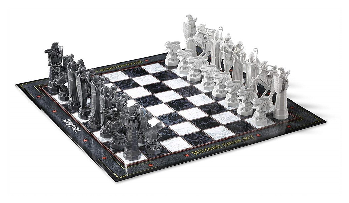

Такие рекомендации


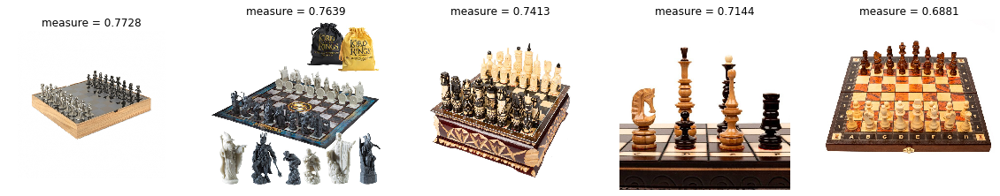

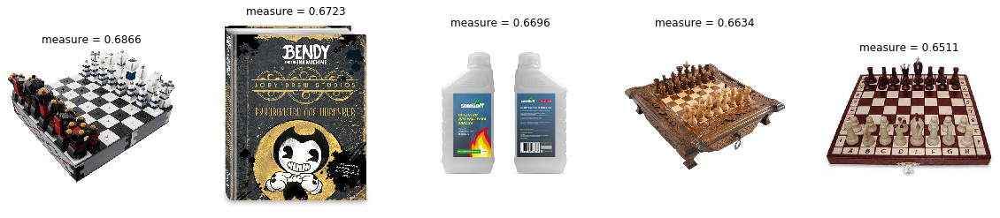

In [70]:
w.get_rec_I2I(6000)

Для товара


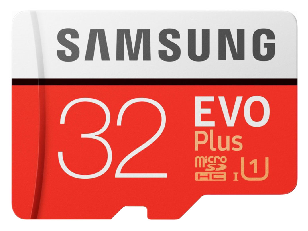

Такие рекомендации


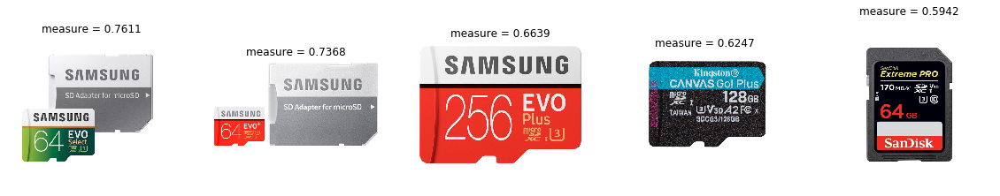

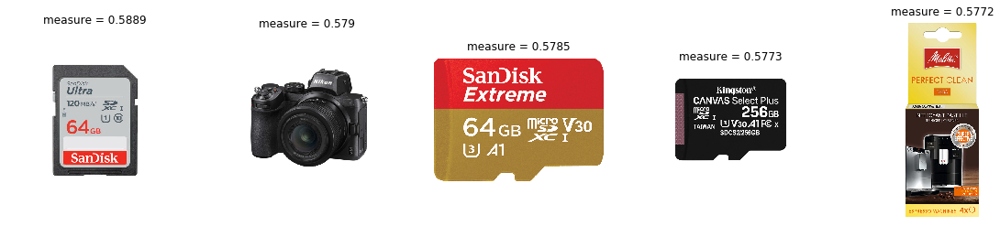

In [71]:
w.get_rec_I2I(60000)

Для товара


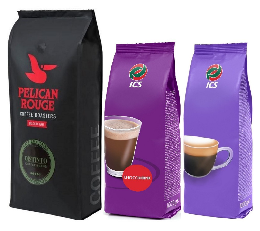

Такие рекомендации


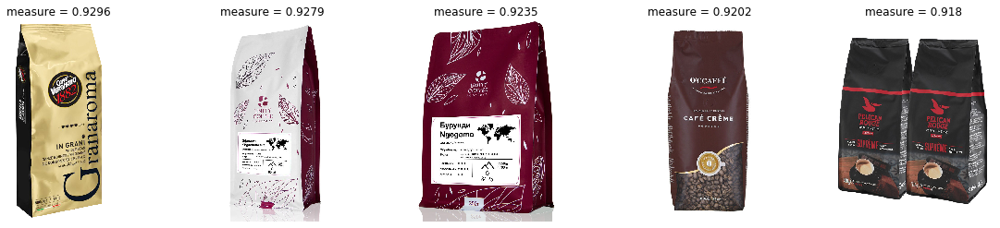

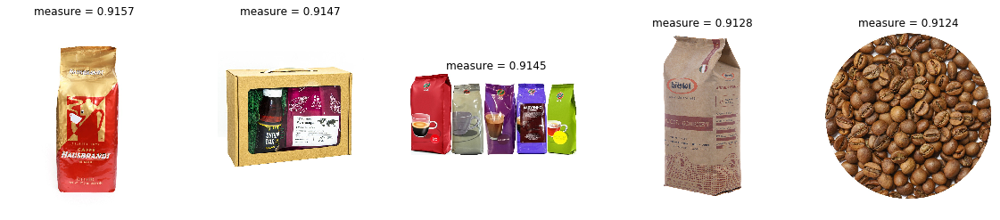

In [72]:
w.get_rec_I2I(5432)

In [76]:
Int[Int["product_id"] == "1332"]

,vid,product_id,page_type,picture_url,text
585997,9155,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
585998,15973,1332,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
585999,15973,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586000,15974,1332,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586001,15974,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586002,15975,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586003,15976,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586004,15977,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586005,15978,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...
586006,15979,1332,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Умная кофеварка Redmond SkyCoffee M1519S Silve...


Для товара


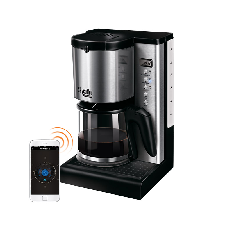

Такие рекомендации


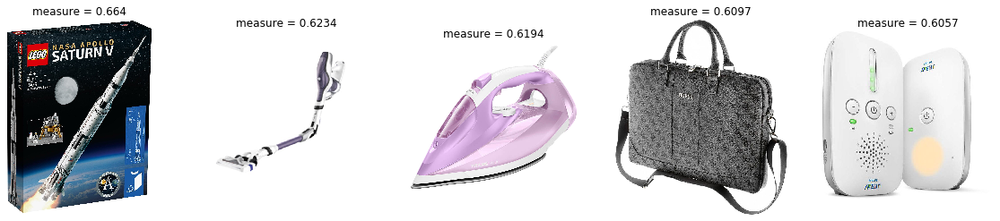

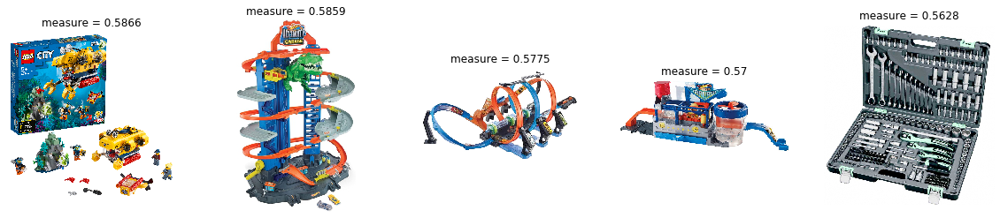

In [75]:
w.get_rec_I2I(1332)

Для товара


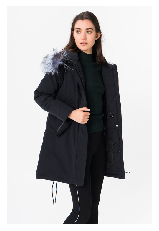

Такие рекомендации


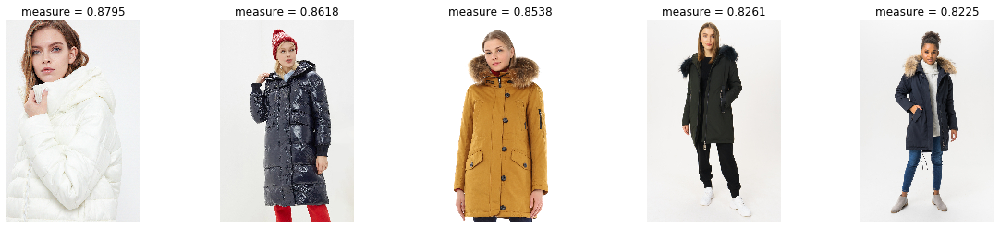

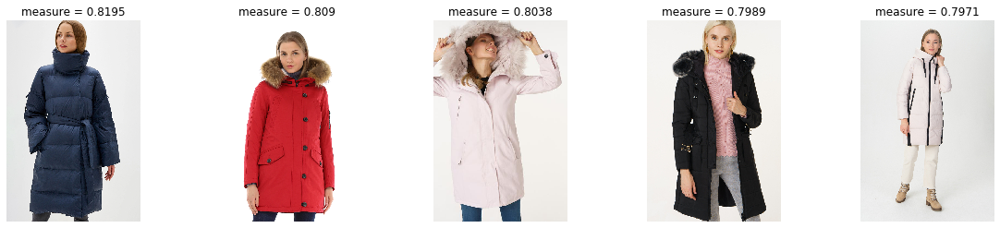

In [78]:
w.get_rec_I2I(132)

Для пользователя, который взаимодействовал с товарами


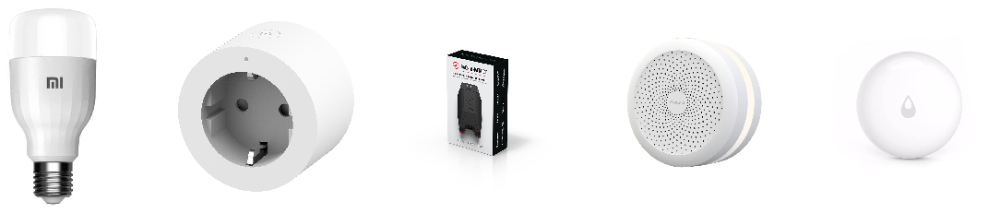

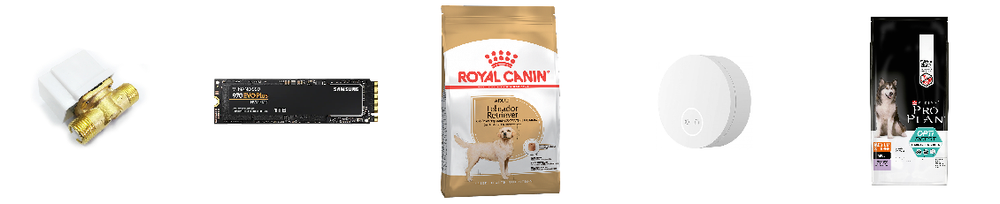

Такие рекомендации


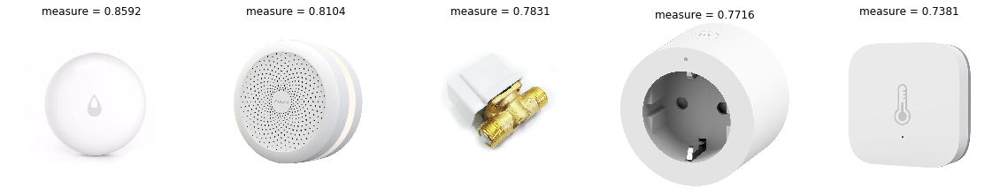

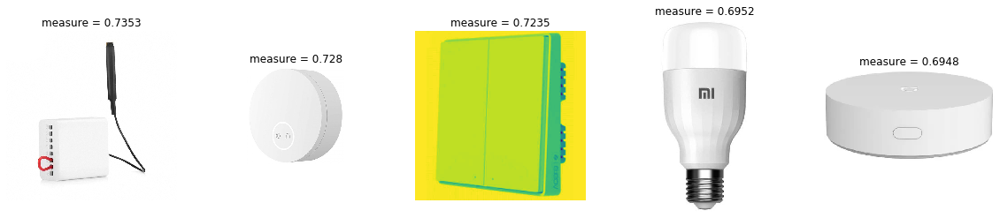

In [79]:
w.get_rec_U2I(3245)

Для пользователя, который взаимодействовал с товарами


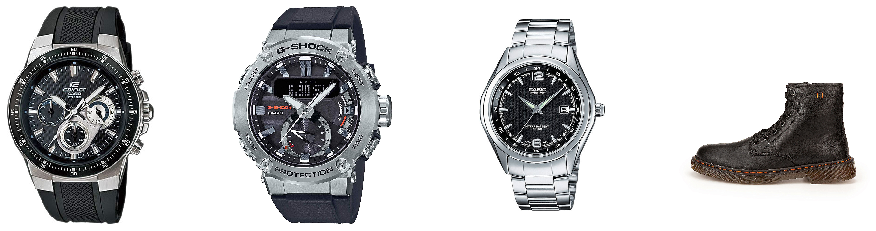

Такие рекомендации


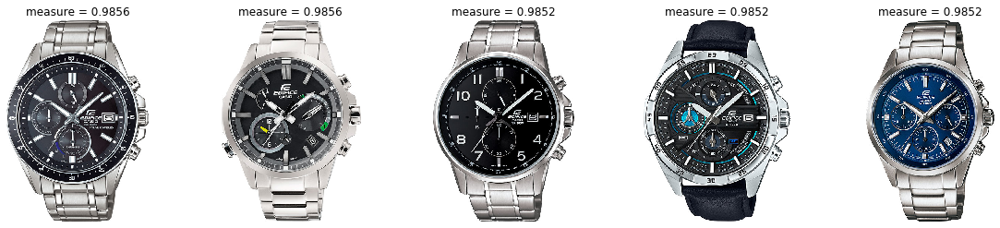

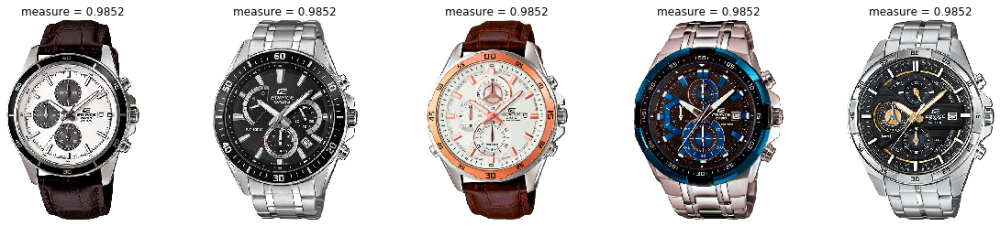

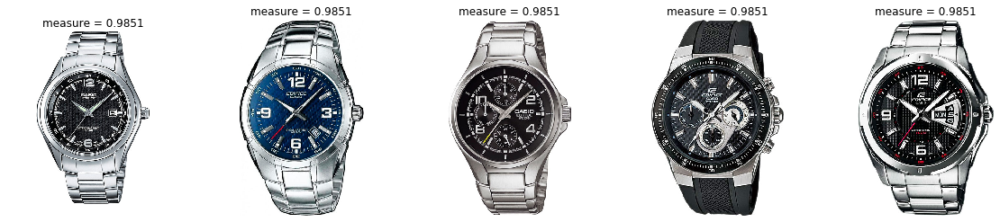

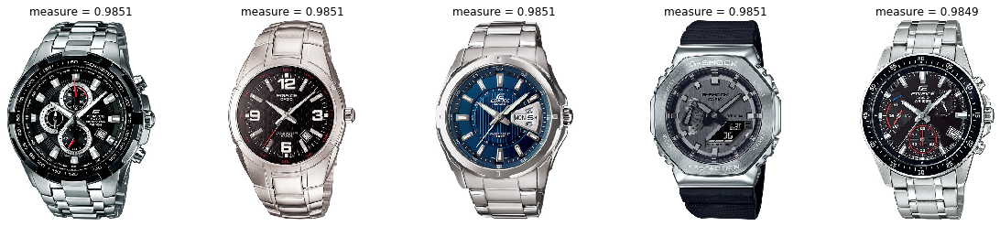

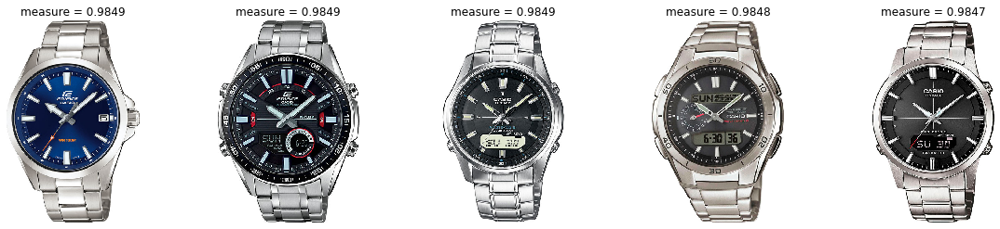

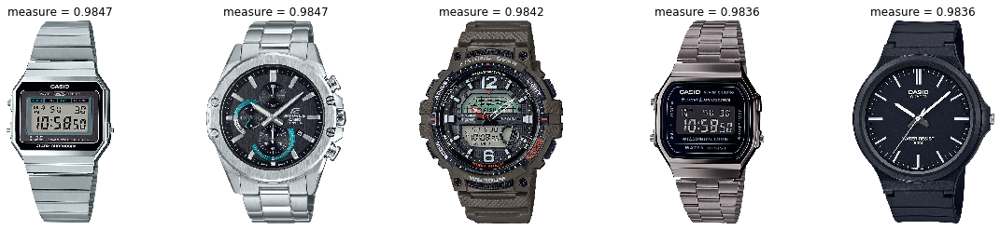

Для пользователя, который взаимодействовал с товарами


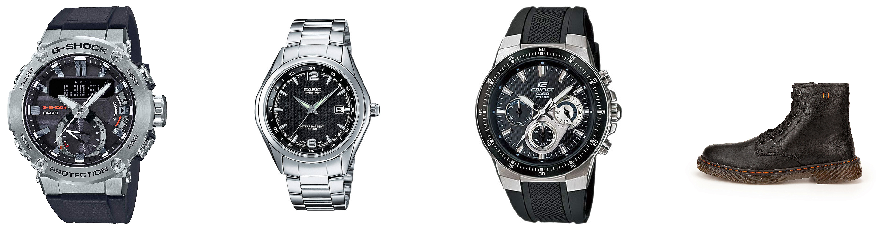

Такие рекомендации


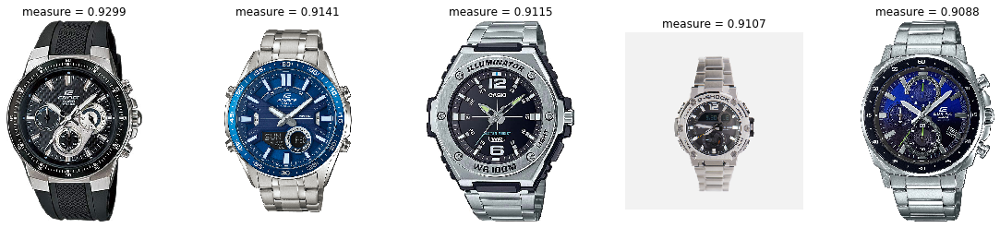

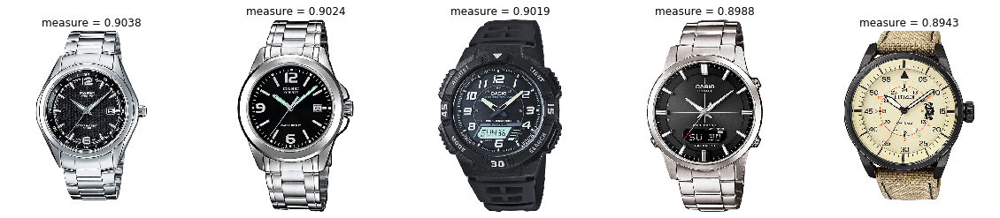

In [81]:
user = 5555
CB.get_rec_U2I(user)
w.get_rec_U2I(user)

# Colloborative filtering

In [203]:
ex_df = pd.DataFrame([[1, 0, 0, 1, 0, 0],
              [0, 0, 0, 1, 0, 1],
              [1, 1, 0, 1, 0, 1],
              [0, 0, 0, 0, 1, 1],
              [0, 0, 0, 0, 1, 1],
              [1, 1, 0, 1, 0, 1]], columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

In [204]:
ex_df

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,1,0,0,1,0,0
Петя,0,0,0,1,0,1
Паша,1,1,0,1,0,1
Олег,0,0,0,0,1,1
Марина,0,0,0,0,1,1
Вероника,1,1,0,1,0,1


In [205]:
user_rates = ex_df.iloc[1].values

In [223]:
user_rates

array([0, 0, 0, 1, 0, 1])

In [225]:
1 - user_rates.astype(bool)

array([1, 1, 1, 0, 1, 0])

In [226]:
1 - user_rates

array([1, 1, 1, 0, 1, 0])

In [221]:
watched_items

array([3, 5])

In [ ]:
user_rates = self.csr_rates.getrow(idx).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
# считаем косинус между пользователем idx и всеми пользователями
metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
# чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]

In [209]:
metrics = cosine_similarity([user_rates], ex_df.values).reshape(-1, 1)

In [210]:
metrics

array([[0.5       ],
       [1.        ],
       [0.70710678],
       [0.5       ],
       [0.5       ],
       [0.70710678]])

In [212]:
rates = ex_df.values * metrics

In [213]:
rates

array([[0.5       , 0.        , 0.        , 0.5       , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , 1.        , 0.        ,
        1.        ],
       [0.70710678, 0.70710678, 0.        , 0.70710678, 0.        ,
        0.70710678],
       [0.        , 0.        , 0.        , 0.        , 0.5       ,
        0.5       ],
       [0.        , 0.        , 0.        , 0.        , 0.5       ,
        0.5       ],
       [0.70710678, 0.70710678, 0.        , 0.70710678, 0.        ,
        0.70710678]])

In [214]:
pd.DataFrame(rates, columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"],
            index=["Вася", "Петя", "Паша", "Олег", "Марина", "Вероника"])

,яблоко,груша,апельсин,ананас,кокос,виноград
Вася,0.500000,0.000000,0.0,0.500000,0.0,0.000000
Петя,0.000000,0.000000,0.0,1.000000,0.0,1.000000
Паша,0.707107,0.707107,0.0,0.707107,0.0,0.707107
Олег,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Марина,0.000000,0.000000,0.0,0.000000,0.5,0.500000
Вероника,0.707107,0.707107,0.0,0.707107,0.0,0.707107


In [227]:
total_rate = (1 - user_rates) * np.array(np.sum(rates, axis=0))

In [228]:
pd.DataFrame([total_rate], columns=["яблоко", "груша", "апельсин", "ананас", "кокос", "виноград"])

,яблоко,груша,апельсин,ананас,кокос,виноград
0,1.914214,1.414214,0.0,0.0,1.0,0.0


In [217]:
watched_items = np.where(user_rates != 0)[0]

In [218]:
watched_items

array([3, 5])

In [102]:
# Для простоты положим, что вес у всех типов взаимодействий одинаковый
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})

weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

In [103]:
weighted["weight"] = (weighted["weight"] > 0).astype(int)

In [104]:
weighted["vid_encoded"] = le.fit_transform(weighted["vid"])
weighted["product_id_encoded"] = le.fit_transform(weighted["product_id"])

In [105]:
# заполним sparse матрицу
csr_rates = coo_matrix((weighted["weight"], (weighted["vid_encoded"], weighted["product_id_encoded"])), 
                    shape=(len(set(weighted["vid_encoded"])), len(set(weighted["product_id_encoded"]))))

In [106]:
csr_rates

<212948x60240 sparse matrix of type '<class 'numpy.int64'>'
	with 795458 stored elements in COOrdinate format>

In [107]:
user_rates = csr_rates.getrow(0).toarray()[0]

In [108]:
measure = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)

In [109]:
np.sort(measure.ravel())[-11:-1]

array([0.28867513, 0.28867513, 0.28867513, 0.28867513, 0.28867513,
       0.28867513, 0.28867513, 0.28867513, 0.33333333, 0.40824829])

In [110]:
idx = 0

In [111]:
user_rates = csr_rates.getrow(idx).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
metrics = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_rates.copy(), metrics)

In [112]:
rates

<212948x60240 sparse matrix of type '<class 'numpy.float64'>'
	with 795458 stored elements in COOrdinate format>

In [113]:
user_rates

array([1, 0, 0, ..., 0, 0, 0], dtype=int64)

In [114]:
metrics

array([[1.        ],
       [0.23570226],
       [0.15430335],
       ...,
       [0.        ],
       [0.        ],
       [0.        ]])

In [115]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        # считаем косинус между пользователем idx и всеми пользователями
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        # считаем косинус между товаром idx и всеми пользователями
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [116]:
Int

,vid,product_id,page_type,picture_url,text
0,0,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
1,1,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
2,2,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
3,3,0,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
4,4,0,CART,https://main-cdn.sbermegamarket.ru/hlr-system/...,Мягкая игрушка Мульти-Пульти Чебурашка с пласт...
...,...,...,...,...,...
915609,211599,58093,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Натяжитель поликлинового ремня с роликом Ina 5...
915610,211887,55271,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,"Книга Пойми меня, если сможешь. Почему нас не ..."
915611,212209,58296,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Электровентилятор Отопителя Luzar LFh1755 Вен...
915612,212213,58296,PRODUCT,https://main-cdn.sbermegamarket.ru/hlr-system/...,Электровентилятор Отопителя Luzar LFh1755 Вен...


In [117]:
clb = Colloborative(Int)

Для таких товаров


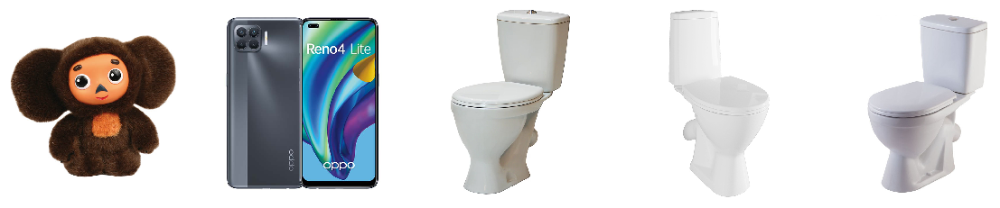

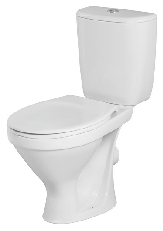

Такие рекомендации


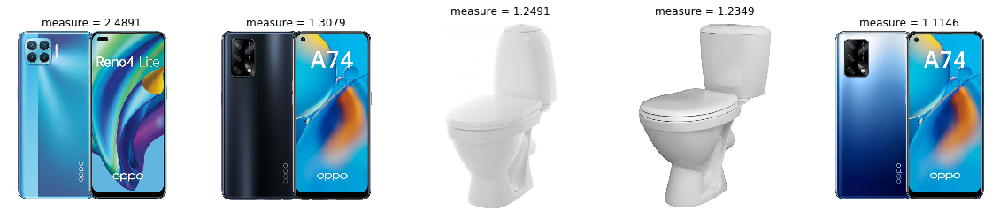

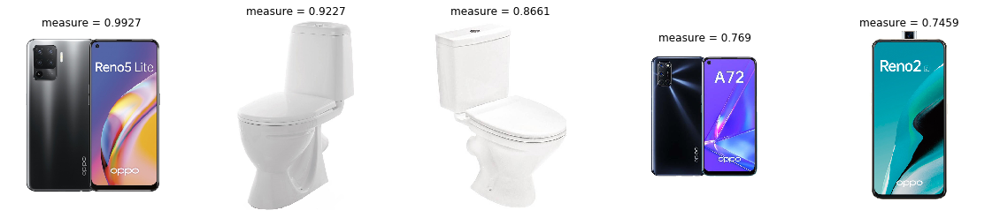

In [119]:
clb.user_based(0)

Для таких товаров


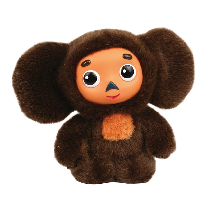

Такие рекомендации


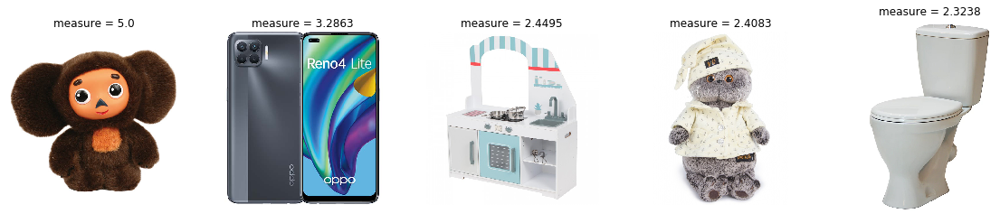

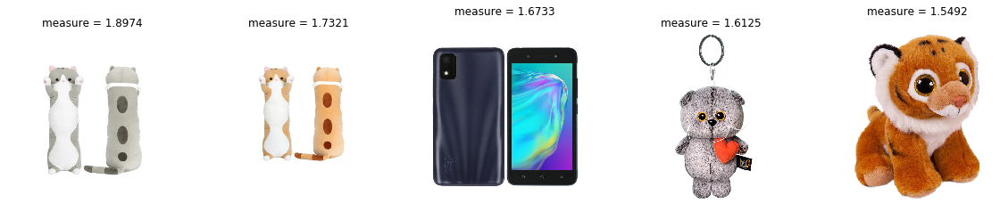

In [379]:
clb.item_based(0)

Для таких товаров


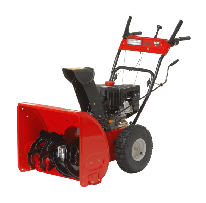

Такие рекомендации


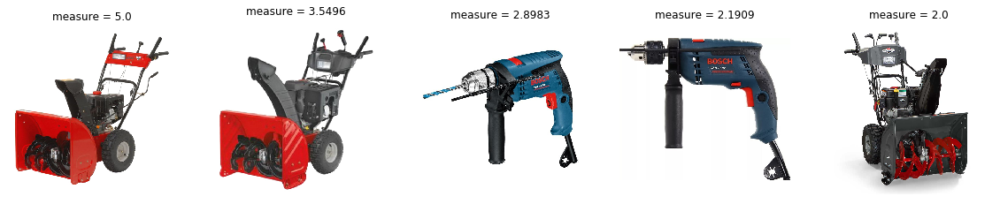

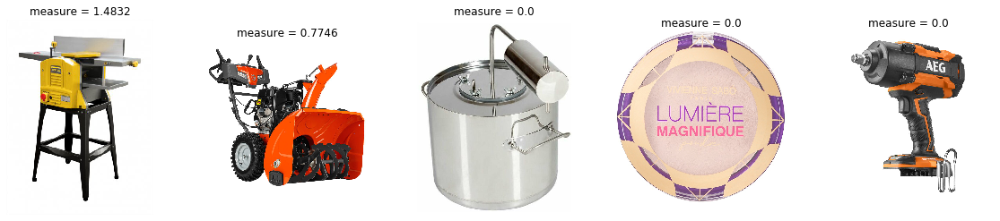

In [381]:
clb.item_based(12)

Для таких товаров


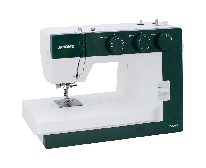

Такие рекомендации


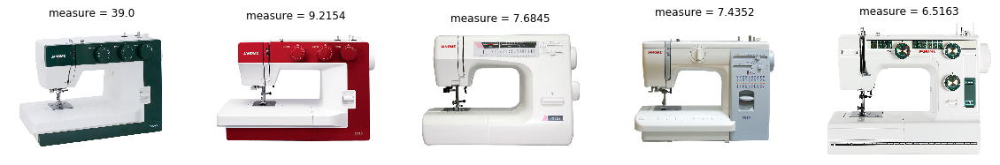

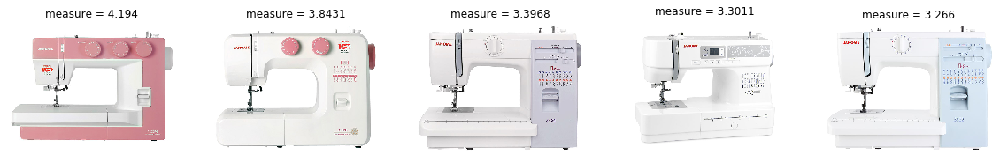

In [382]:
clb.item_based(31211)

Для таких товаров


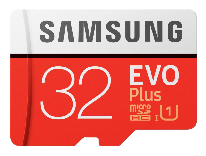

Такие рекомендации


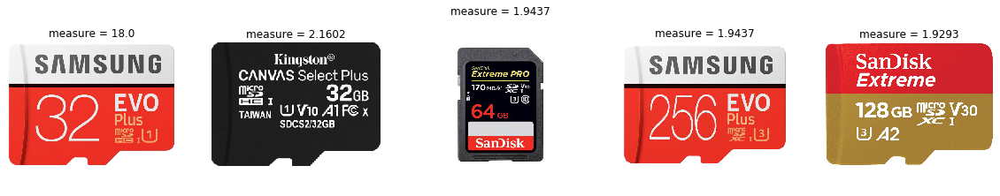

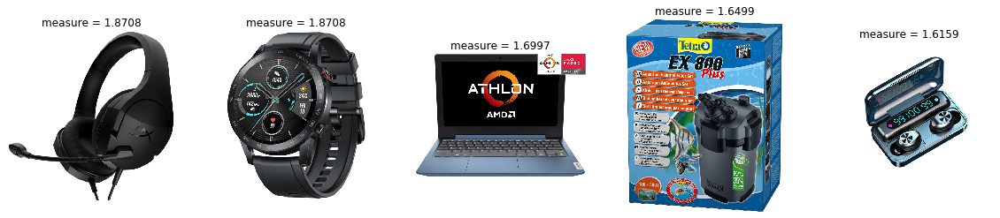

In [383]:
clb.item_based(60000)

Для таких товаров


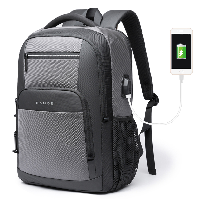

Такие рекомендации


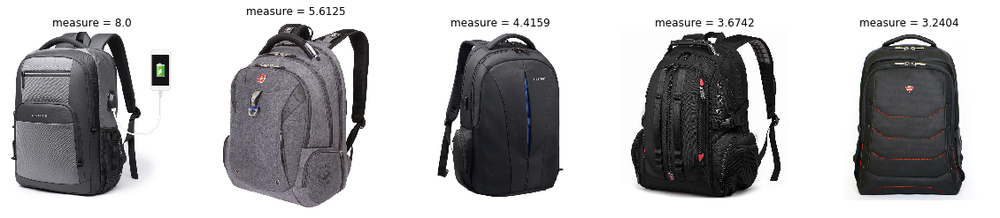

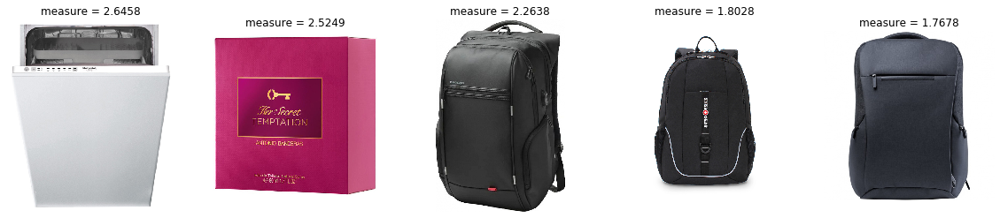

In [384]:
clb.item_based(2556)

Для таких товаров


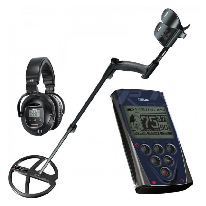

Такие рекомендации


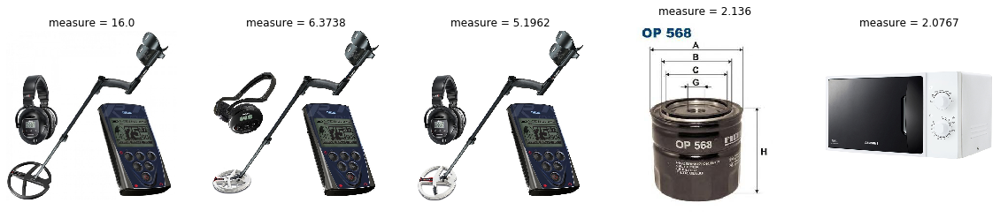

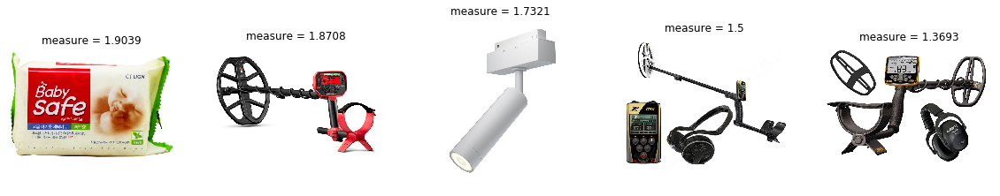

In [385]:
clb.item_based(4041)

Для таких товаров


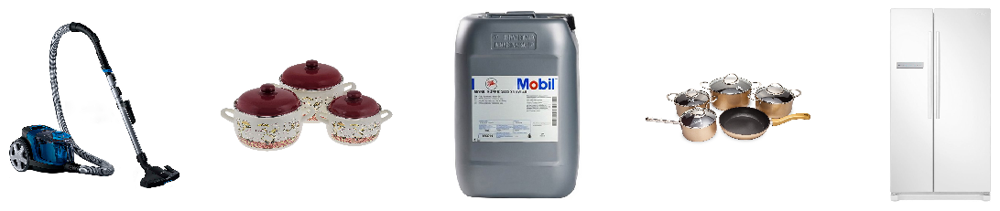

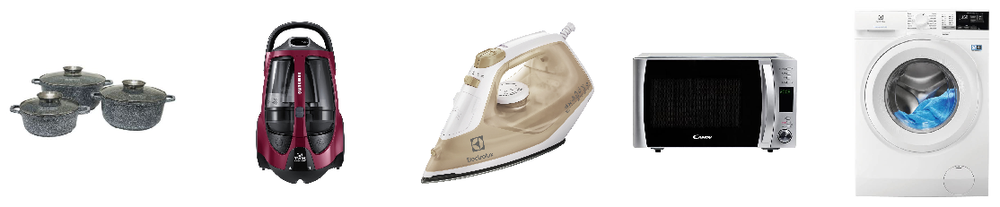

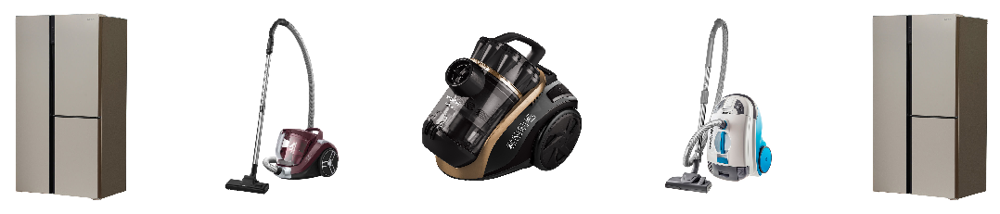

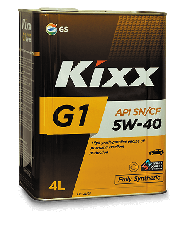

Такие рекомендации


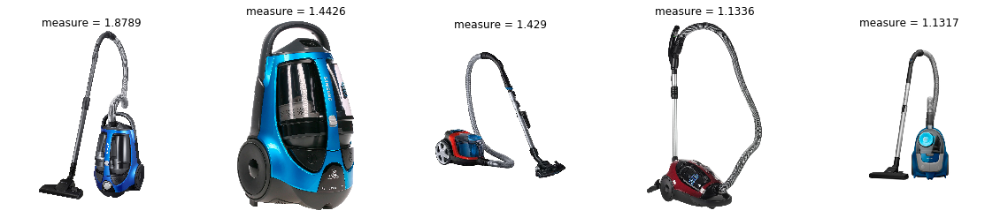

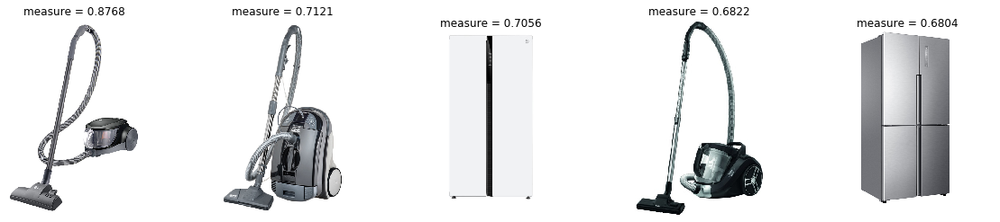

In [387]:
clb.user_based(444)

Для таких товаров


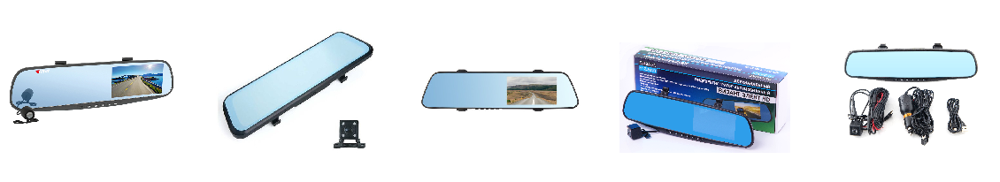

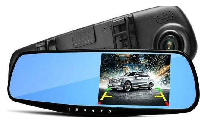

Такие рекомендации


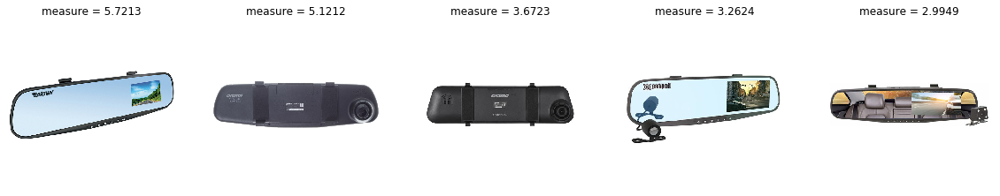

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/PIL/Image.py:2942: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)


Something went wrong with https://main-cdn.sbermegamarket.ru/hlr-system/-14/024/213/409/241/548/600004646110b0.webp


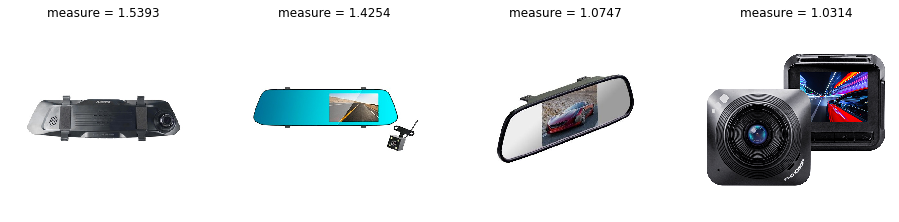

In [388]:
clb.user_based(404)

Для таких товаров


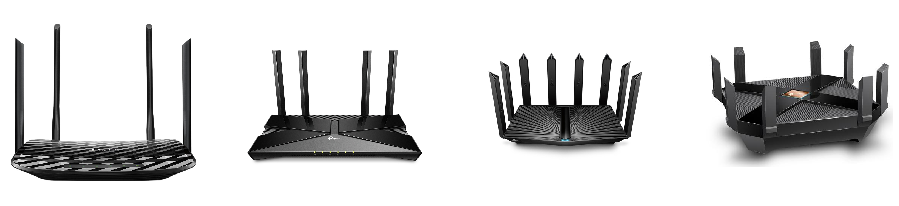

Такие рекомендации


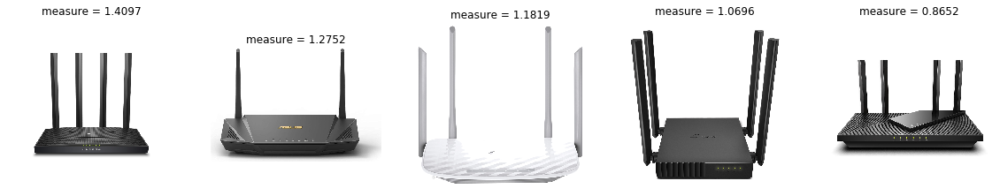

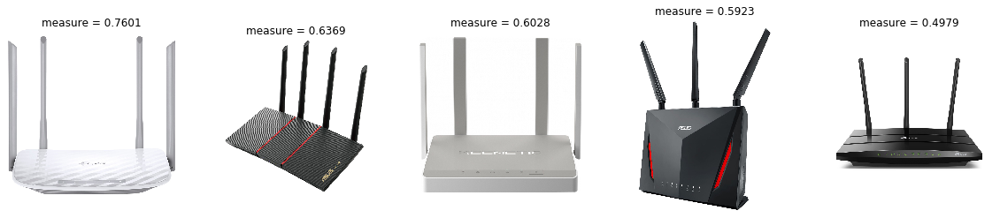

In [389]:
clb.user_based(12345)

Для таких товаров


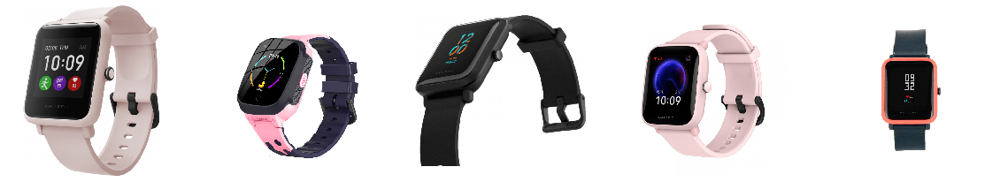

Такие рекомендации


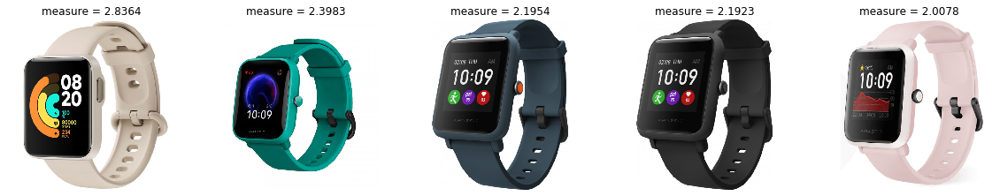

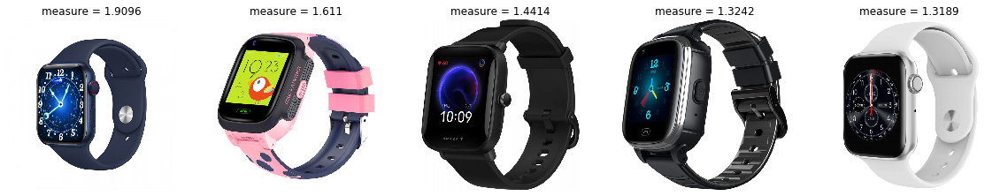

In [390]:
clb.user_based(123456)

Для таких товаров


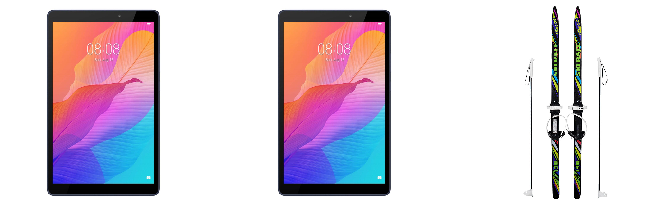

Такие рекомендации


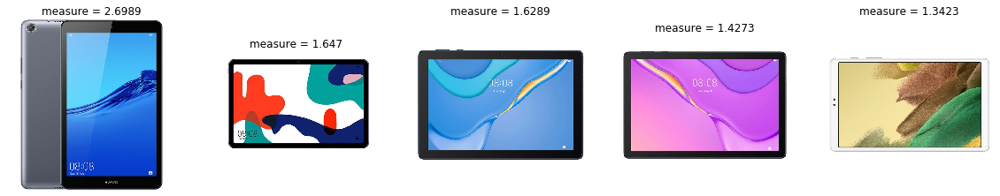

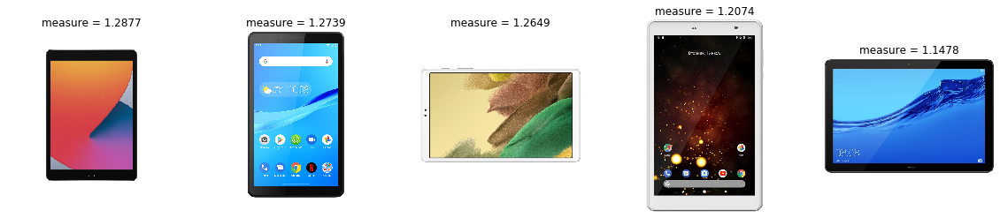

In [391]:
clb.user_based(34434)

Для таких товаров


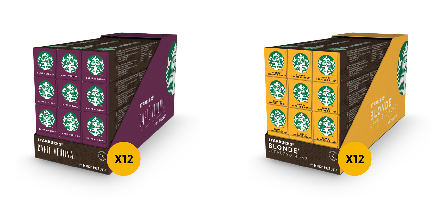

Такие рекомендации


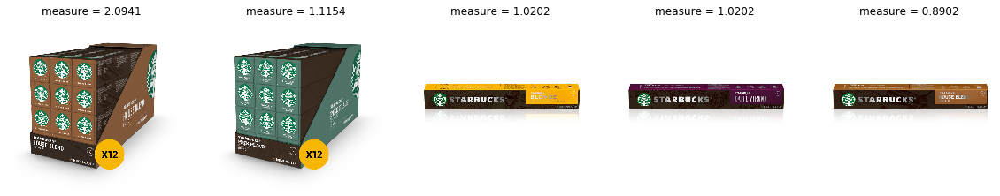

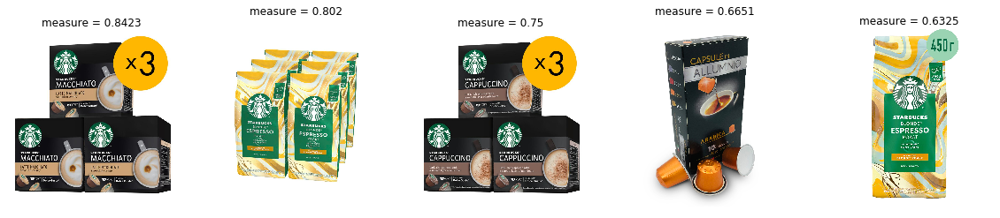

In [392]:
clb.user_based(3333)

Для таких товаров


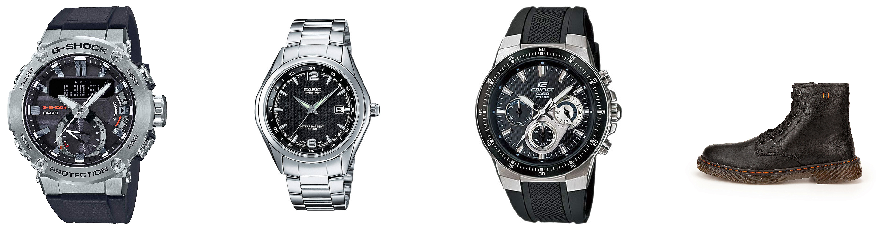

Такие рекомендации


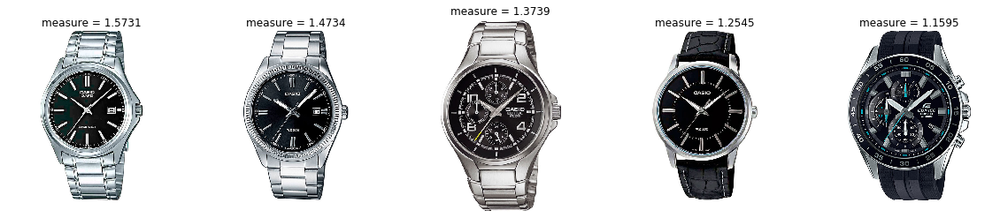

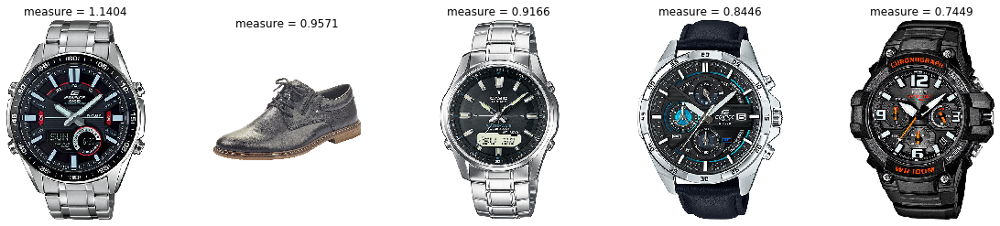

In [393]:
clb.user_based(5555)

Для таких товаров


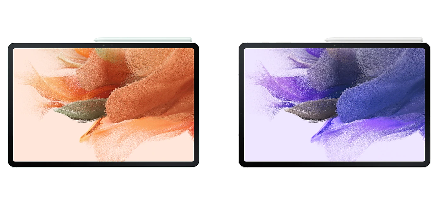

Такие рекомендации


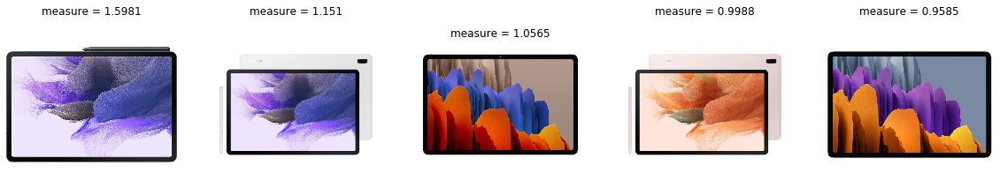

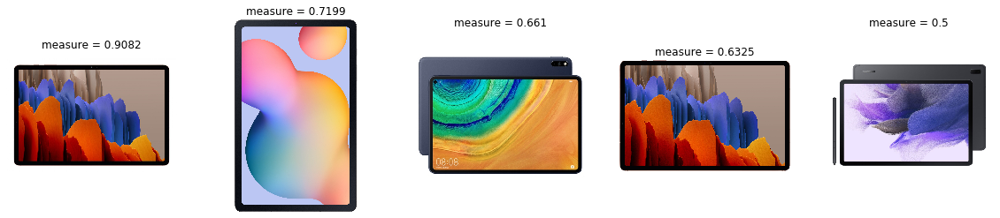

In [394]:
clb.user_based(77777)

Для таких товаров


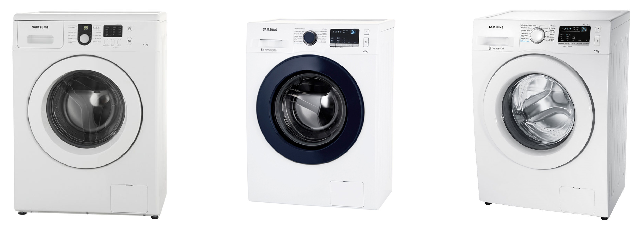

Такие рекомендации


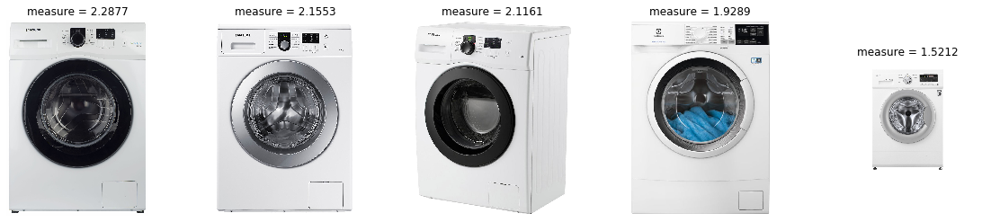

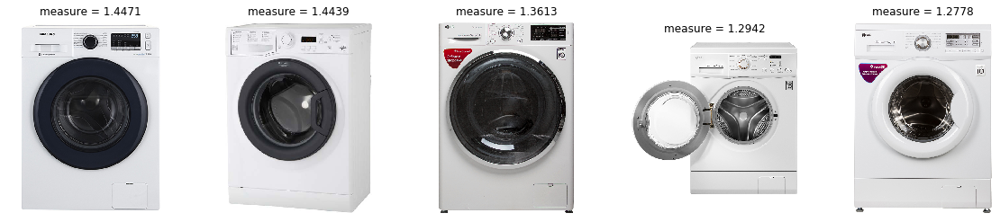

In [395]:
clb.user_based(5)

Для таких товаров


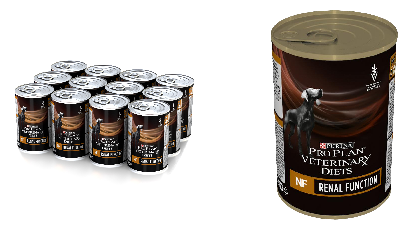

Такие рекомендации


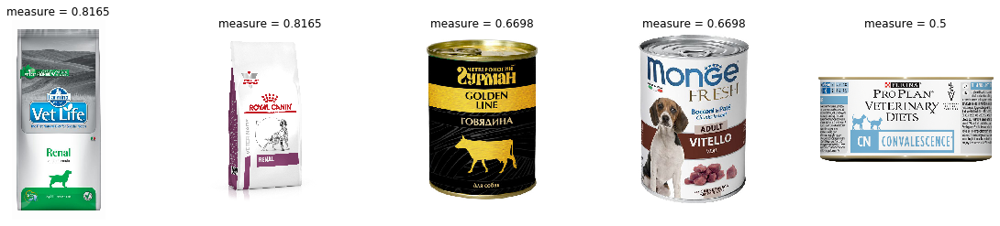

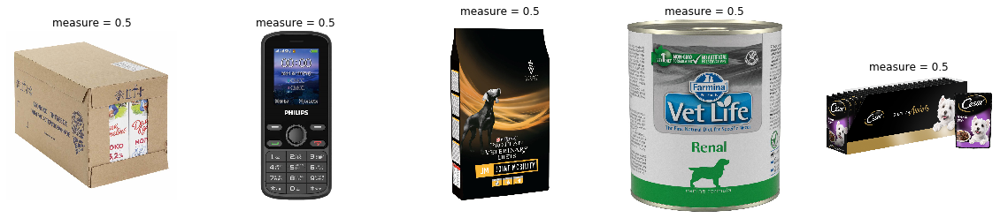

In [396]:
clb.user_based(323)

# Matrix Factorization

In [199]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [200]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


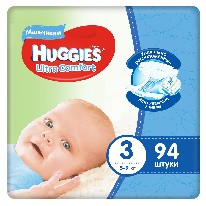

Такие рекомендации


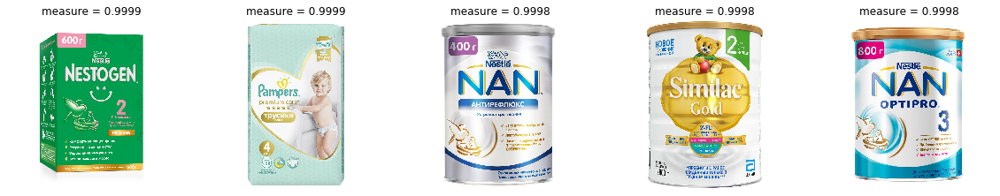

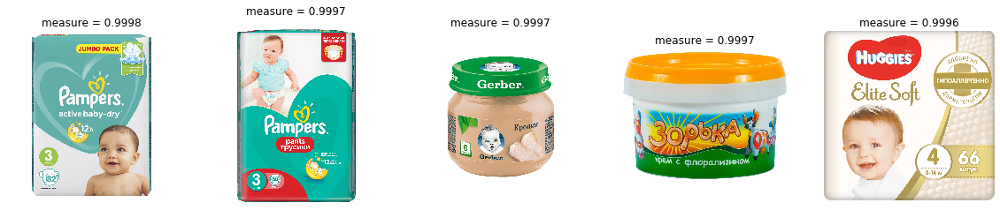

In [397]:
simple_svd.get_rec(1222)

Для товара


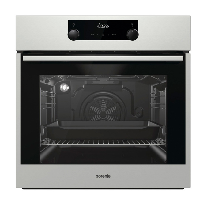

Такие рекомендации


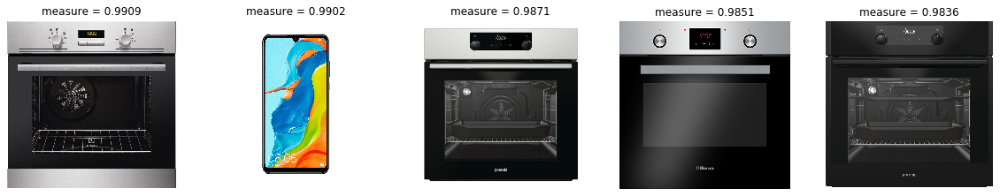

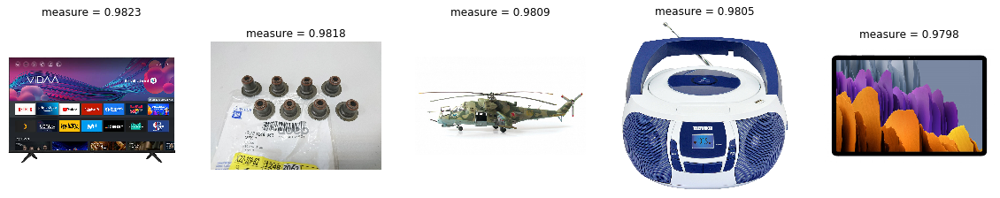

In [398]:
simple_svd.get_rec(402)

Для товара


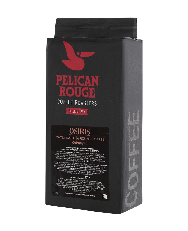

Такие рекомендации


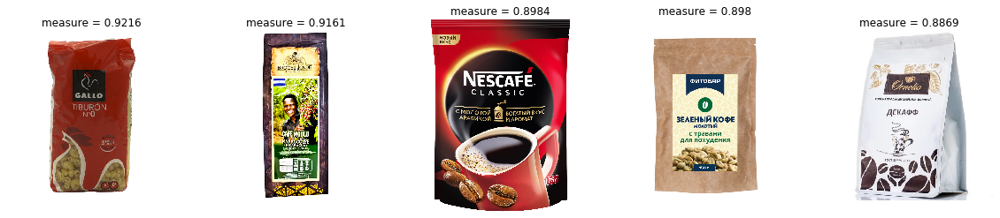

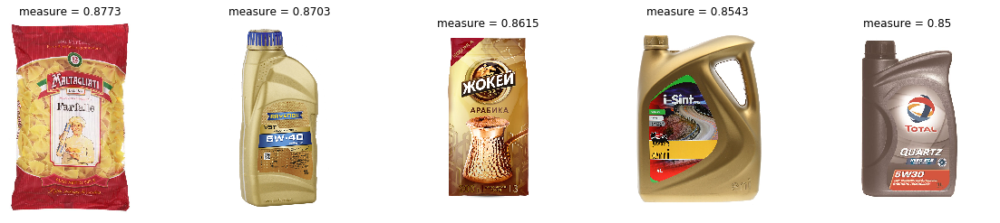

In [399]:
simple_svd.get_rec(56244)

Для товара


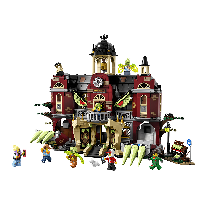

Такие рекомендации


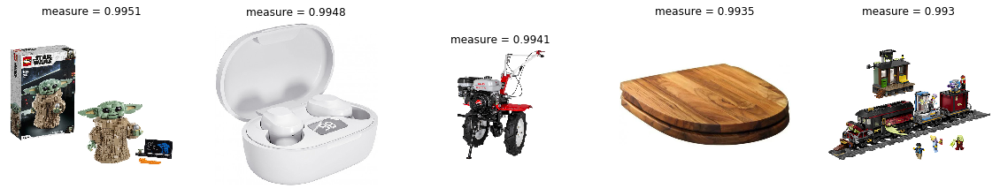

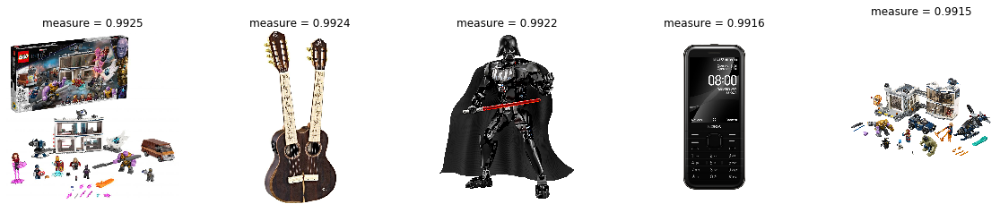

In [400]:
simple_svd.get_rec(406)

Для товара


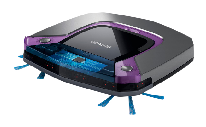

Такие рекомендации


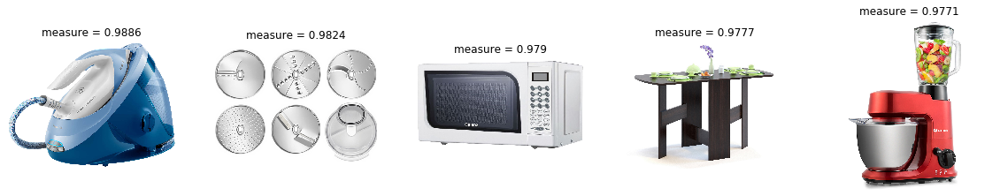

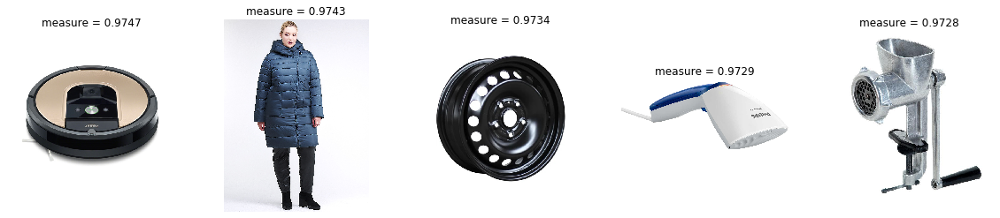

In [401]:
simple_svd.get_rec(3404)

Для товара


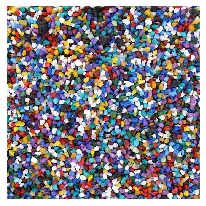

Такие рекомендации


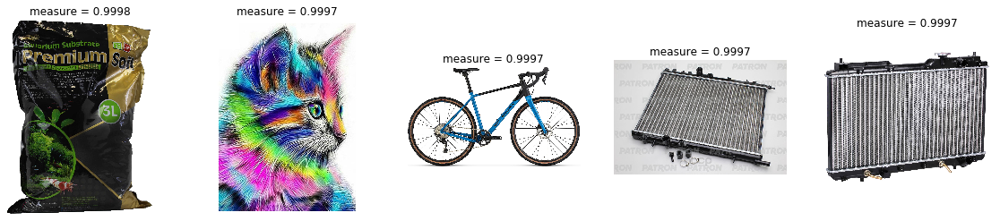

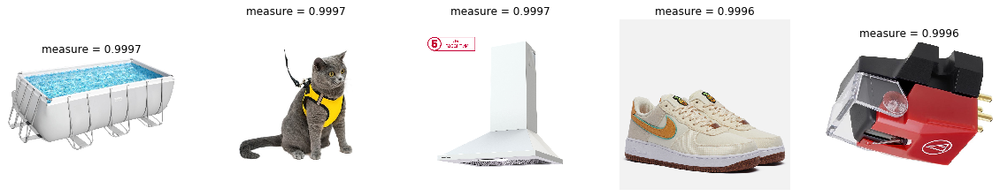

In [402]:
simple_svd.get_rec(111)

Для товара


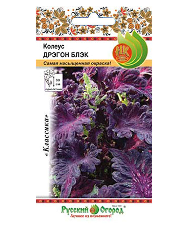

Такие рекомендации


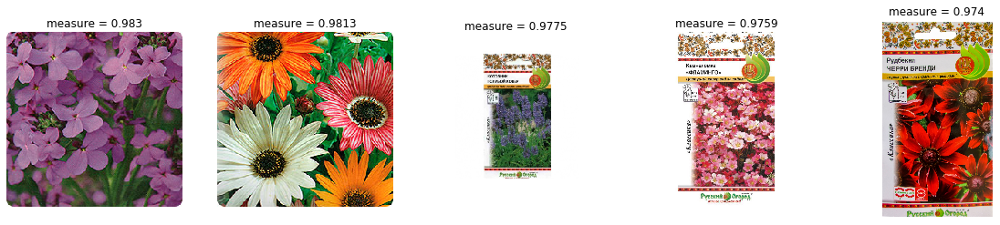

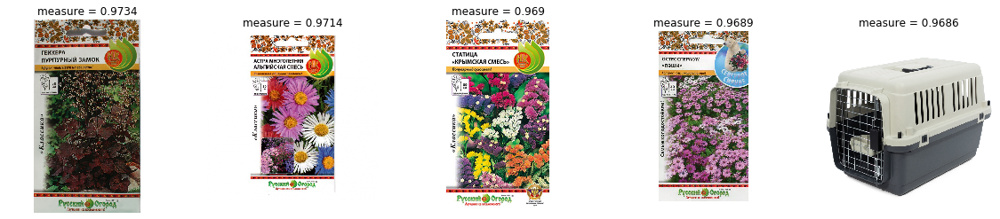

In [403]:
simple_svd.get_rec(12345)

Для товара


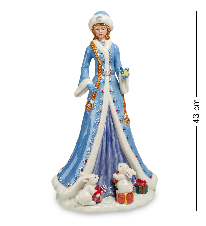

Такие рекомендации


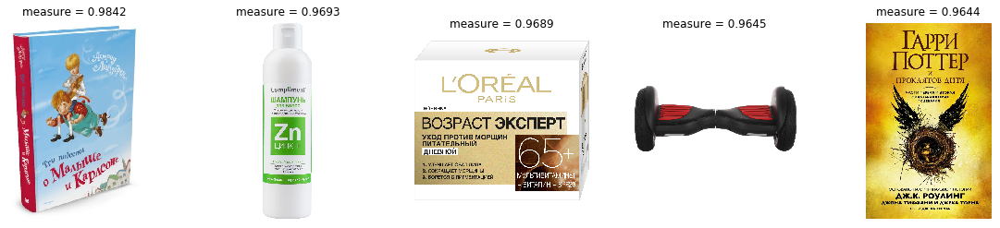

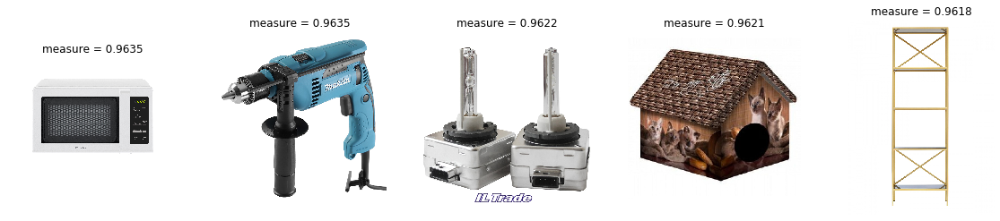

In [405]:
simple_svd.get_rec(5431)

# LightFM

In [201]:
mf = MatrixFactorization(Int, 300)
mf.LightFM()

Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4


Для товара


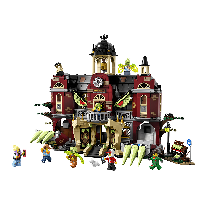

Такие рекомендации


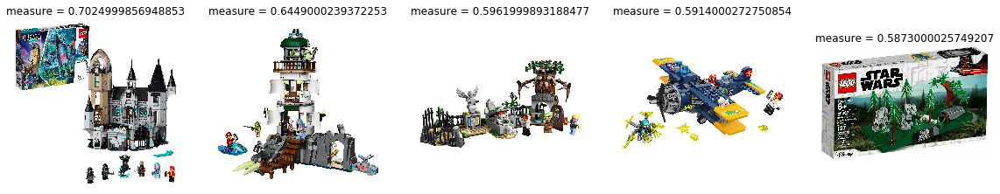

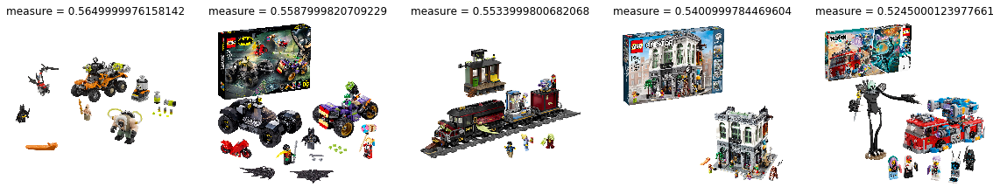

In [406]:
mf.get_rec(406)

Для товара


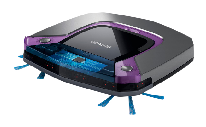

Такие рекомендации


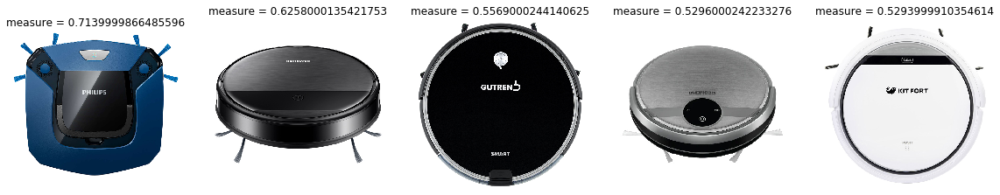

/Users/v.zhuravlyov/anaconda2/envs/notebook-6.0.1/lib/python3.7/site-packages/PIL/Image.py:2942: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)


Something went wrong with https://main-cdn.sbermegamarket.ru/hlr-system/156/594/746/197/134/8/100025549494b0.jpg


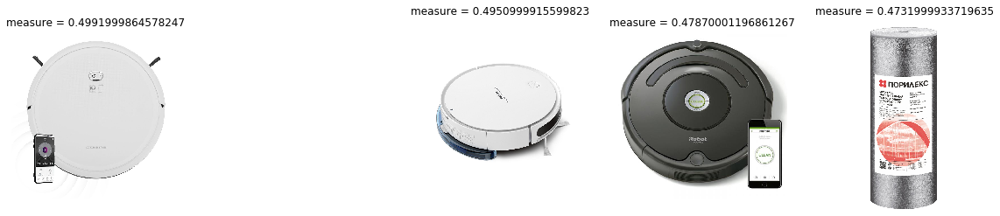

In [408]:
mf.get_rec(3404)

# ALS

$\min\limits_{q^*,p^*}\sum\limits_{u,i}(r_{ui} - q_i^Tp_u)^2 + \lambda(||q_i||^2 + ||p_u||^2)$

In [ ]:
LATENT_SIZE = 5

lambda_p = 0.0
lambda_q = 0.0

Посчитаем количество пользователей и товаров

In [ ]:
n_users = Int["vid"].value_counts().shape[0]
n_items = Int["product_id"].value_counts().shape[0]

Инициализируем латентные представления для пользователей и товаров

In [410]:
p = 0.1 * np.random.random((n_users, LATENT_SIZE))
q = 0.1 * np.random.random((n_items, LATENT_SIZE))

In [411]:
p

array([[0.04700276, 0.00892922, 0.05294334, ..., 0.02545059, 0.00055378,
        0.03989416],
       [0.04815858, 0.04410536, 0.07190149, ..., 0.00867724, 0.01664685,
        0.08839678],
       [0.03928326, 0.08014658, 0.08075603, ..., 0.07273595, 0.04842137,
        0.01800344],
       ...,
       [0.09396227, 0.08720363, 0.03119821, ..., 0.04470539, 0.08080555,
        0.04431001],
       [0.07711992, 0.04831477, 0.07856496, ..., 0.03208578, 0.04410457,
        0.09587656],
       [0.01983546, 0.07483966, 0.03438961, ..., 0.08274472, 0.06919408,
        0.09296788]])

In [412]:
q

array([[0.0079737 , 0.07649532, 0.07652198, ..., 0.07926048, 0.02267752,
        0.00856161],
       [0.07662397, 0.0570575 , 0.00190005, ..., 0.08966004, 0.09208275,
        0.01986686],
       [0.01279702, 0.01346558, 0.02645162, ..., 0.03973485, 0.02764003,
        0.07373679],
       ...,
       [0.03523578, 0.03487407, 0.05471512, ..., 0.00457583, 0.08735856,
        0.09305402],
       [0.02297002, 0.07412756, 0.0175196 , ..., 0.01421435, 0.04681763,
        0.021476  ],
       [0.00022604, 0.02427814, 0.01164004, ..., 0.0730219 , 0.02827426,
        0.09372135]])

In [232]:
from collections import defaultdict

In [231]:
# Для простоты положим, что вес у всех типов взаимодействий одинаковый
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})

weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

weighted["weight"] = (weighted["weight"] > 0).astype(int)

nums = weighted.groupby("vid")["product_id"].count().reset_index().rename(columns={"product_id": "product_num"})

weighted = weighted.merge(nums[nums["product_num"] > 5], on=["vid"]).drop(columns=["product_num"])

Составим словарь взаимодействий по товару

In [233]:
train_by_item = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_item[i].append((u, r))

Составим словарь взаимодействий по пользователю

In [234]:
train_by_user = defaultdict(list)
for u, i, _, r in weighted.values:
    train_by_user[u].append((i, r))

Теперь составим матрицу $P$ из векторов $p_u$ и матрицу Q из векторов $q_i$. Матрицей $Q[u] \in \mathbb{R}^{n_u \times K}$ будем обозначать подматрицу матрицы $Q$ только для товаров, оцененных пользователем $u$, где $n_u$ - количество оценок пользователя $u$.

Шаг перенастройки $p_u$ при фиксированной матрице $Q$ будет выглядеть следующим образом:


$$
A_u = Q[u]^TQ[u]
$$

$$
d_u = Q[u]^Tr_u
$$

$$
p_u = (\lambda_pI + A_u)^{-1}d_u
$$


In [ ]:
def compute_p(p, q, train_by_user):
    for u, rated in train_by_user.items():
        rated_items = [i for i, _ in rated]
        Au = q[rated_items].T.dot(q[rated_items])
        ratings = [i for _, i in rated]
        du = q[rated_items].T.dot(ratings)
        p[u] = np.linalg.inv(lambda_p * np.eye(Au.shape[0]) + Au).dot(du)
    return p

Шаг для перенастройки $q_i$ при фиксированной матрице $P$ будет считаться аналогично

In [ ]:
def compute_q(p, q, train_by_item):
    for i, rated in train_by_item.items():
        rated_users = [u for u, _ in rated]
        Au = p[rated_users].T.dot(p[rated_users])
        ratings = [u for _, u in rated]
        du = p[rated_users].T.dot(ratings)
        q[i] = np.linalg.inv(lambda_q * np.eye(Au.shape[0]) + Au).dot(du)
    return q

In [ ]:
from tqdm.notebook import tqdm_notebook

In [419]:
LATENT_SIZE = 100

lambda_p = 0.1
lambda_q = 0.01

p = np.random.random((n_users, LATENT_SIZE))
q = np.random.random((n_items, LATENT_SIZE))

In [ ]:
for i in tqdm_notebook(range(2)):
    p = compute_p(p, q, train_by_user)
    q = compute_q(p, q, train_by_item)

In [ ]:
np.save("q_iter_20_good.npy", q)

In [146]:
q = np.load("q_iter_200.npy")

In [147]:
product_id_to_url = {}
for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
    product_id_to_url[i[0]] = i[1]

In [148]:
def get_rec_I2I(q, i):
    metrics = cosine_similarity([q[i]], q)
    print(u"Для товара")
    rec_imaging([i], product_id_to_url)
    print(u"Такие рекомендации")
    rec_imaging(np.argsort(metrics)[0][::-1][1:11], product_id_to_url, np.sort(metrics)[0][::-1][1:11])

In [236]:
q.shape

(60627, 100)

Для товара


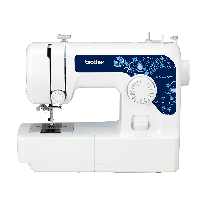

Такие рекомендации


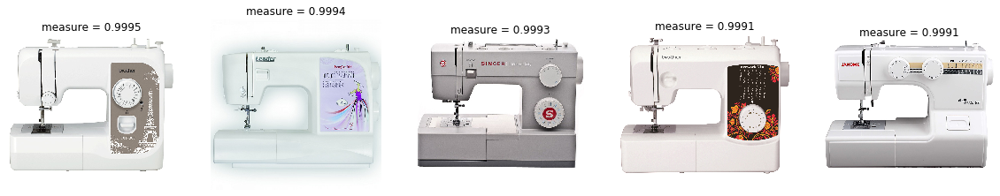

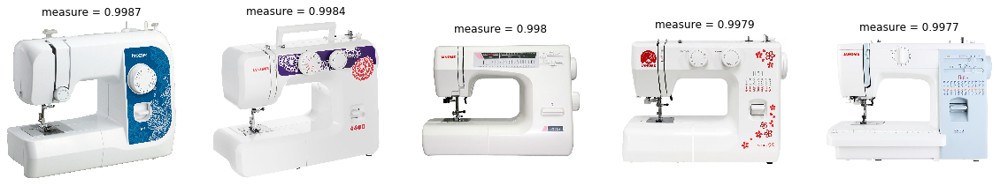

In [150]:
get_rec_I2I(q, 16666)

Для товара


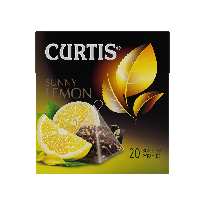

Такие рекомендации


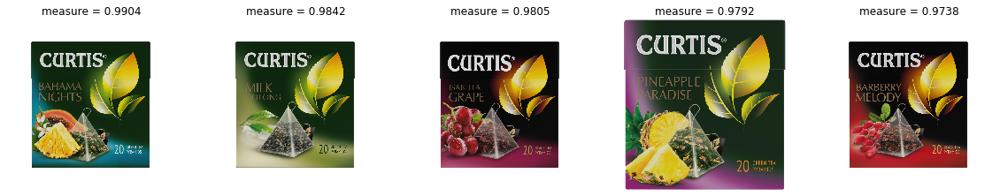

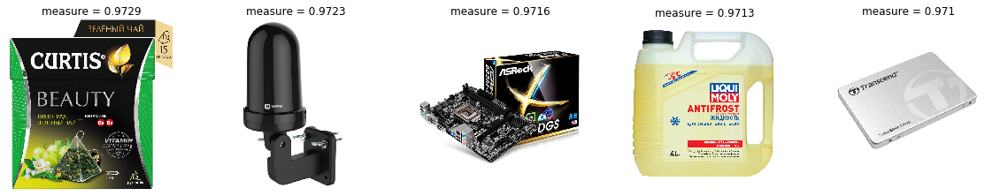

In [151]:
get_rec_I2I(q, 40591)

Для товара


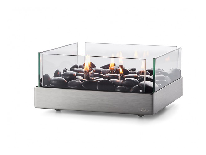

Такие рекомендации


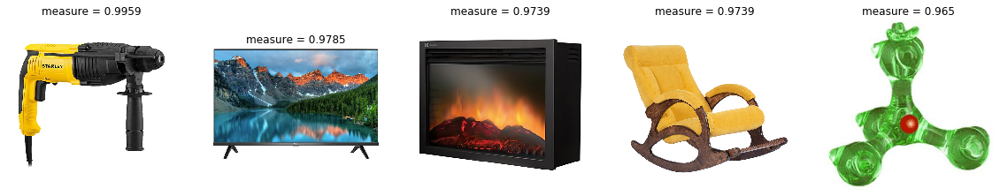

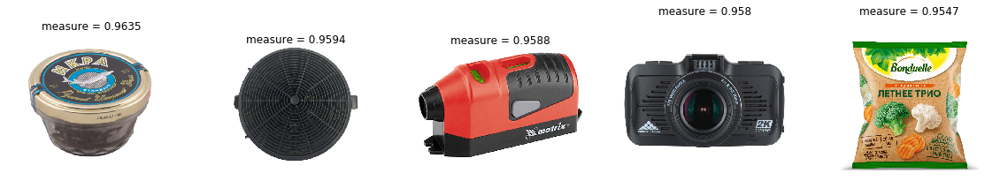

In [152]:
get_rec_I2I(q, 58791)

Для товара


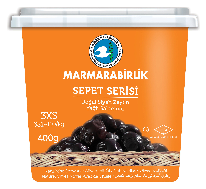

Такие рекомендации


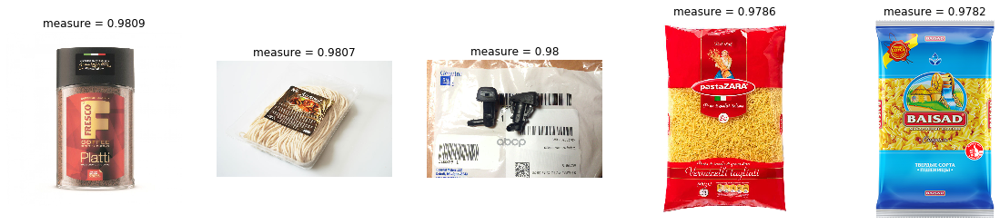

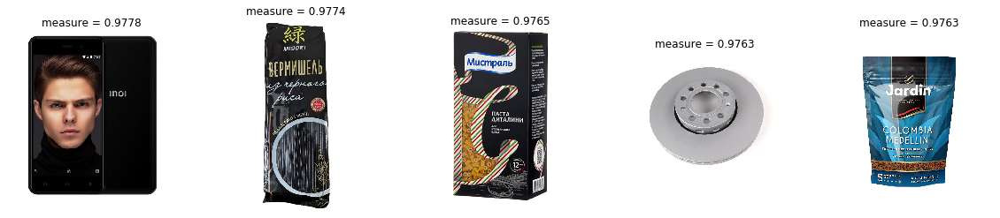

In [153]:
get_rec_I2I(q, 1213)

Для товара


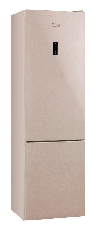

Такие рекомендации


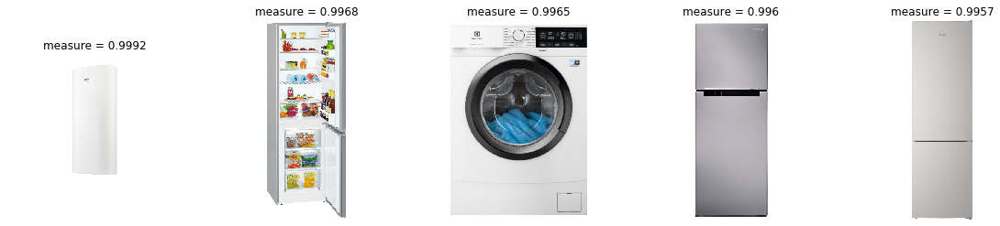

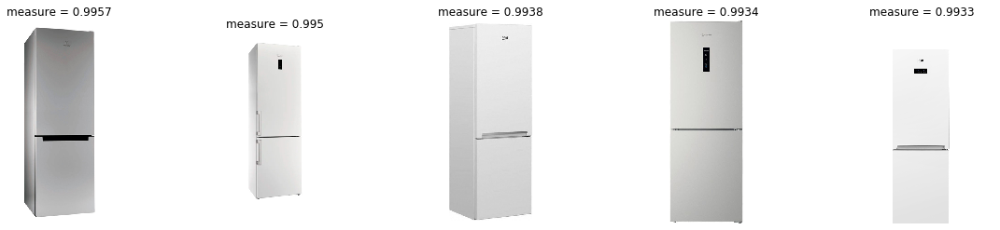

In [154]:
get_rec_I2I(q, 40000)

Для товара


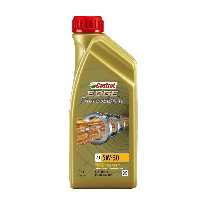

Такие рекомендации


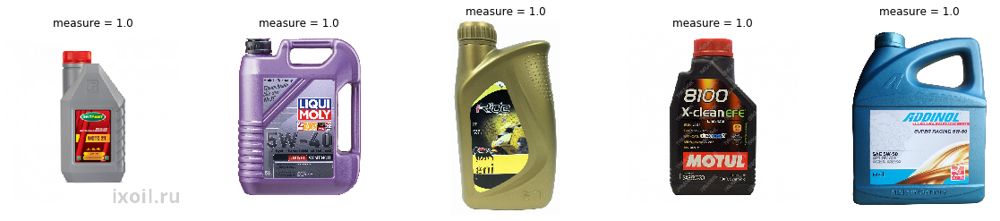

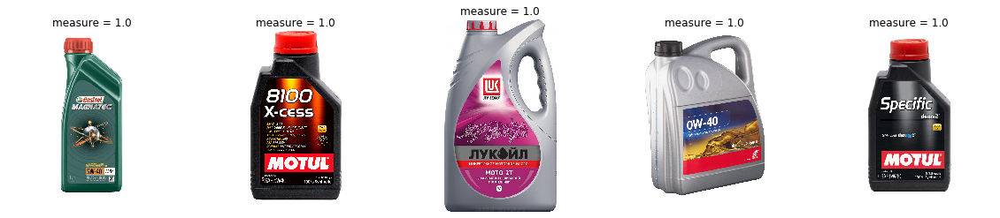

In [157]:
get_rec_I2I(q, 12010)

Для товара


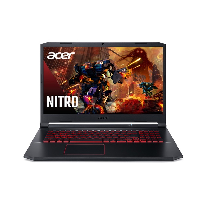

Такие рекомендации


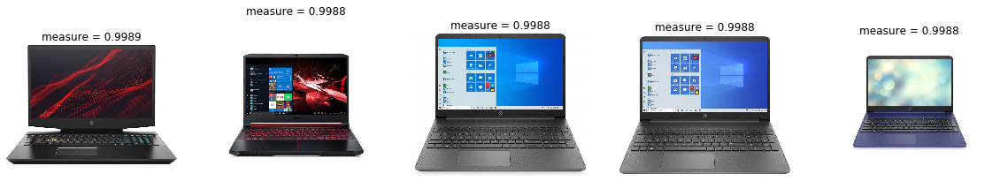

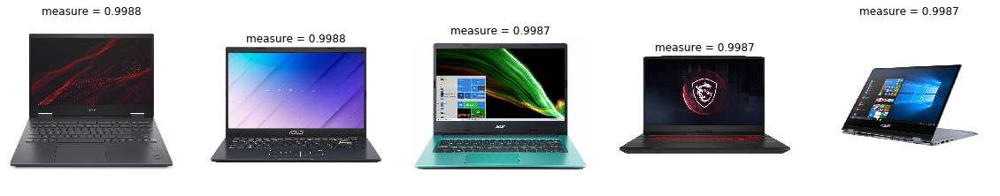

In [158]:
get_rec_I2I(q, 2000)

Для товара


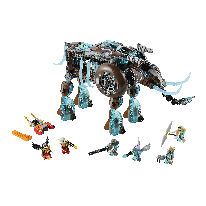

Такие рекомендации


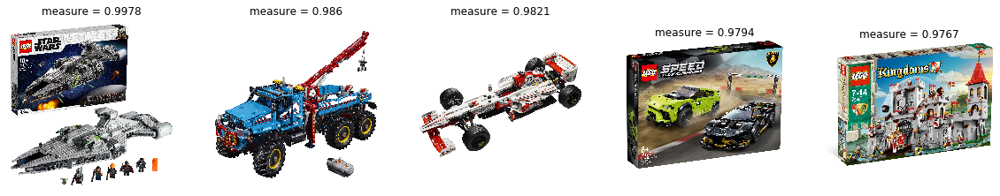

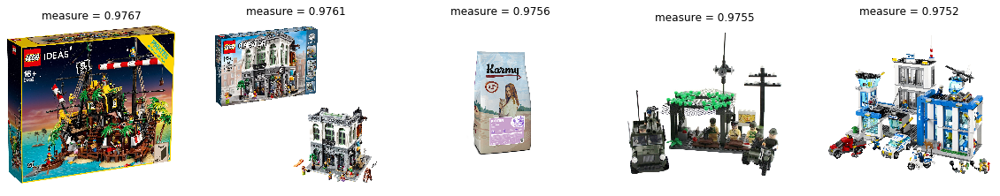

In [159]:
get_rec_I2I(q, 43601)

Для товара


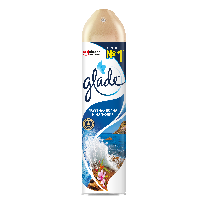

Такие рекомендации


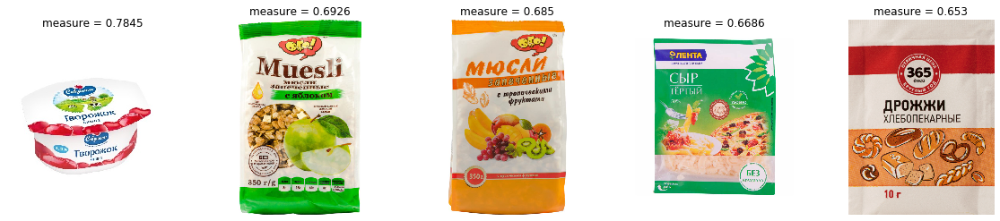

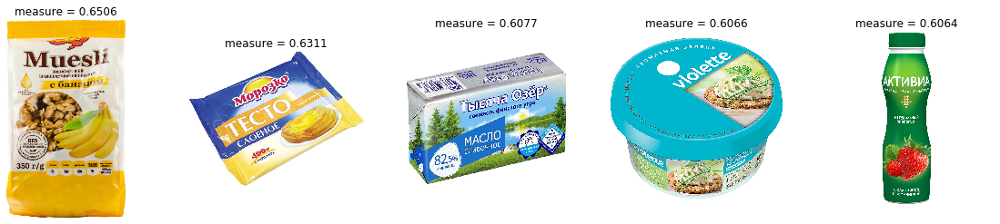

In [438]:
get_rec_I2I(q, 1745)

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход возраст и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 27) - 3 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Совстречаемость - 3 балла

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок.

### 4. Коллаборативная фильтрация - 3 балла

Коллаборативную фильтрацию реализовывать как на слайде 51 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл. Реализовать U2I и I2I рекомендации.

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации

Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)

Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Жесткий дедлайн 20 мая 23:59

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.

In [ ]:
books = pd.read_csv("BX-Books.csv")

In [ ]:
interactions = pd.read_csv("BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [ ]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [ ]:
interactions

In [ ]:
books

In [ ]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [ ]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [ ]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [ ]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [ ]:
users = pd.read_csv('BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [ ]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [ ]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [ ]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [ ]:
interactions.head()

In [ ]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [ ]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "David Copperfield" in j:
        print("idx:", i, "\tBook Title:", j)